# Fudan PRML22 Fall Final Project

*Your name and Student ID: [公超], [20307140043]*

*Complete and hand in this completed worksheet (including its outputs and any supporting code outside of the worksheet, and a .pdf report file) with your assignment submission.*




**Congratulations, you have come to the last challenge!**

Having finished the past two assignments, we think all you gugs already have a solid foundation in the field of machine learning and deep learning. And now you are qualified to apply machine learning algorithms to the real-world tasks you are interested in, or start your machine learning research.

In this final project, you are free to choose a topic you are passionate about. The project can be an application one, a theoretical one or implementing your own amazing machine learning or deep learning framework like a toy pytorch. If you don't have any idea, we also provide you with a default one you can play with.

## Default Project: Text-Iamge Transformation

<img src="./figures/text2image.jpg" width = "300" height = "300" alt="Text-Iamge Transformation" align=center />

### Track One: Image Caption 
> **TA**: Give an introduction to the **image caption** task.

> **ChatGPT**: The image caption task is the process of generating a natural language description of an image. This is a difficult problem in artificial intelligence because it requires the model to not only understand the content of the image, but also to use natural language processing techniques to generate a coherent and accurate description. In recent years, significant progress has been made in this field thanks to the development of deep learning models that can learn to automatically generate descriptive captions for images. These models are typically trained on large datasets of images and their corresponding captions, and can generate descriptions that range from simple labels to more complex and detailed sentences. The goal of the image caption task is to create systems that can automatically generate accurate and informative descriptions of images, which can be useful for a variety of applications such as image search and accessibility for the visually impaired.

### Track Two: Text-to-Iamge
> **TA**: Give an introduction to the **text-to-image** task.

> **ChatGPT**: The text-to-image task is the process of generating an image based on a given natural language description. This is a challenging problem in artificial intelligence because it requires the model to understand the meaning of the text and then generate an image that accurately reflects that meaning. This task is related to the image caption task, but is more difficult because it involves generating an image from scratch rather than just describing an existing image. In recent years, significant progress has been made in this field thanks to the development of deep learning models that can learn to generate images from text descriptions. These models are typically trained on large datasets of images and their corresponding captions, and can generate a wide range of images that are consistent with the given text description. The goal of the text-to-image task is to create systems that can automatically generate realistic images from natural language descriptions, which can be useful for a variety of applications such as image generation and data augmentation for computer vision tasks.``

### Dataset
> **TA**: Give an introduction to the Flickr30k dataset.

> **ChatGPT**: The Flickr30k dataset is a collection of 30,000 images and their corresponding natural language captions. It is one of the most widely used datasets for the image caption task, and has been used in many research papers and benchmark studies. The dataset was created by collecting images from the Flickr website and then having human annotators provide descriptive captions for each image. The captions in the dataset are written in natural language and describe the contents of the images in a variety of ways, ranging from simple labels to more detailed sentences. The Flickr30k dataset is an important resource for researchers working on the image caption task because it provides a large and diverse set of images and captions that can be used to train and evaluate image captioning models.

The Flickr30k dataset can be downloaded via this [link](http://shannon.cs.illinois.edu/DenotationGraph/data/index.html),
- Images: Flickr 30k images.
- Texts: Publicly Distributable Version of the Flickr 30k Dataset (image links + captions)

 or you can use this dataset on the PaddlePaddle platform directly. 

### Precautions
- You can use your favorite framework like PyTorch, but we can't provide computing power for it for the time being;
- You can use public pre-trained models, but we value your overall workload more than the final performance;
- Done is Better Than Perfect. Implement the simplest model first, and then keep improving it.

### Resources
- Google;
- Papers from top ML/DL/CV/NLP venues; 
- [NNDL Chap15: Sequence Generation Model](https://nndl.github.io/nndl-book.pdf);
- [Sequence-to-Sequence Learning Tutorial](https://github.com/bentrevett/pytorch-seq2seq): A tutorial implementing neural (deep learning based) sequence-to-sequence models in PyTorch with torchtext, by implementing six NMT papers;



### Initialization Code

In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import matplotlib.pyplot as plt

In [ ]:
# !unzip ./data/data180670/flickr30k.zip

In [3]:
! cat ./flickr30k/readme.txt

The image captions are released under a CreativeCommons
Attribution-ShareAlike license.

If you  use this corpus, please cite:
P. Young, A. Lai, M. Hodosh, and J. Hockenmaier. From image
description to visual denotations: New similarity metrics for semantic
inference over event descriptions. Transactions of the Association for
Computational Linguistics (to appear).


The captions have already been tokenized.  Each line represents a
caption, and consists of a caption ID and the actual caption.  Caption
IDs are <image file name>#<caption number>.  Any captions whose IDs
share an image file name describe the same image.  As far as we are
aware, all of the images are distinct.


In [ ]:
! head -n 2 ./flickr30k/results_20130124.token

1000092795.jpg#0	Two young guys with shaggy hair look at their hands while hanging out in the yard .
1000092795.jpg#1	Two young , White males are outside near many bushes .


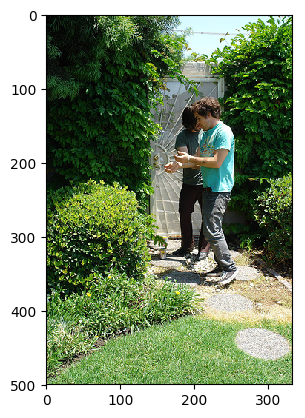

In [ ]:
img = plt.imread('./flickr30k-images/1000092795.jpg')
plt.imshow(img)

Now you can start your road of exploration, hope you enjoy it!

### 1.Explore the dataset

In [4]:
import pandas as pd

annotations = pd.read_table('./flickr30k/results_20130124.token', sep='\t', header=None,
                            names=['image', 'caption'])

In [ ]:
print('There are {} images'.format(len(annotations)/5))
print(annotations)

There are 31783.0 images
                   image                                            caption
0       1000092795.jpg#0  Two young guys with shaggy hair look at their ...
1       1000092795.jpg#1  Two young , White males are outside near many ...
2       1000092795.jpg#2   Two men in green shirts are standing in a yard .
3       1000092795.jpg#3       A man in a blue shirt standing in a garden .
4       1000092795.jpg#4            Two friends enjoy time spent together .
...                  ...                                                ...
158910   998845445.jpg#0  A man in shorts and a Hawaiian shirt leans ove...
158911   998845445.jpg#1  A young man hanging over the side of a boat , ...
158912   998845445.jpg#2  A man is leaning off of the side of a blue and...
158913   998845445.jpg#3  A man riding a small boat in a harbor , with f...
158914   998845445.jpg#4  A man on a moored blue and white boat with hil...

[158915 rows x 2 columns]


可以看出每幅图片有5个描述，一共31783张图片。

10002456.jpg#0


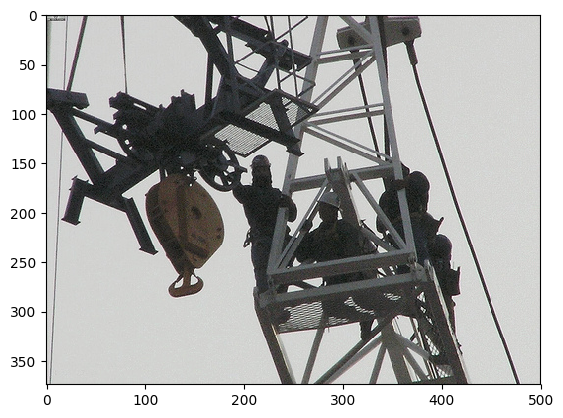

Caption: Several men in hard hats are operating a giant pulley system .
Caption: Workers look down from up above on a piece of equipment .
Caption: Two men working on a machine wearing hard hats .
Caption: Four men on top of a tall structure .
Caption: Three men on a large rig .


In [5]:
# 打几个例子看看
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

data_idx = 5
print(annotations.iloc[data_idx,0])
image_path = './flickr30k-images/'+annotations.iloc[data_idx,0][:-2]
img=plt.imread(image_path)
plt.imshow(img)
plt.show()

for i in range(data_idx,data_idx+5):
    print("Caption:",annotations.iloc[i,1])


# img = plt.imread('./flickr30k-images/1000092795.jpg')
# plt.imshow(img)
# plt.show()

# print(annotations.loc[6]["caption"])
# print(annotations.loc[7]["caption"])
# print(annotations.loc[8]["caption"])
# print(annotations.loc[9]["caption"])
# print(annotations.loc[10]["caption"])

In [ ]:
# 看一下数据类型
print(type(annotations.loc[0]['image']))
print(type(annotations.loc[0]['caption']))

<class 'str'>
<class 'str'>


### 2. Write the custom dataset

In [6]:
import os
from collections import Counter
import sys
sys.path.append('/home/aistudio/work/external-libraries')
import spacy
import paddle
from paddle.io import DataLoader,Dataset
import paddle.vision.transforms as T

from PIL import Image

In [7]:
# 词典类
spacy_eng=spacy.load('en_core_web_sm')
class Vocabulary:
    def __init__(self,freq_threshold):
        # int to string
        # padding, start, end, unknown
        self.itos = {0:"<PAD>",1:"<SOS>",2:"<EOS>",3:"<UNK>"}
        #string to int
        self.stoi = {v:k for k,v in self.itos.items()}
        self.freq_threshold = freq_threshold
        
    def __len__(self):
        return len(self.itos)
    
    @staticmethod
    # spacy可以更好地分词
    def tokenize(text):
        return [token.text.lower() for token in spacy_eng.tokenizer(text)]
    
    def build_vocab(self, sentence_list):
        frequencies = Counter()
        idx = 4
        for sentence in sentence_list:
            for word in self.tokenize(sentence):
                frequencies[word] += 1
                #add the word if it reaches threshold
                if frequencies[word] == self.freq_threshold:
                    self.stoi[word] = idx
                    self.itos[idx] = word
                    idx += 1
    # 将text数值化
    def numericalize(self,text):
        tokenized_text = self.tokenize(text)
        return [ self.stoi[token] if token in self.stoi else self.stoi["<UNK>"] for token in tokenized_text ]   

/home/aistudio/work/external-libraries/spacy/util.py:877: UserWarning: [W095] Model 'en_core_web_sm' (3.0.0) was trained with spaCy v3.0 and may not be 100% compatible with the current version (3.4.4). If you see errors or degraded performance, download a newer compatible model or retrain your custom model with the current spaCy version. For more details and available updates, run: python -m spacy validate
  warnings.warn(warn_msg)


In [ ]:
# 打个例子看看
v=Vocabulary(1)
v.build_vocab(['i love linyi','fudan is an amazing university'])
print('字典：')
print(v.stoi)
print('数值化：',v.numericalize('Tsinghua university, i love you'))

字典：
{'<PAD>': 0, '<SOS>': 1, '<EOS>': 2, '<UNK>': 3, 'i': 4, 'love': 5, 'linyi': 6, 'fudan': 7, 'is': 8, 'an': 9, 'amazing': 10, 'university': 11}
数值化： [3, 11, 3, 4, 5, 3]


In [8]:
# 将数据集数字化
class MyDataset(Dataset):
    def __init__(self,root_dir,flickr_file,transform=None,freq_threshold=5):
        self.root_dir=root_dir
        self.df=pd.read_table(flickr_file, sep='\t', header=None,
                            names=['image', 'caption'])
        self.transform=transform
        self.images=self.df['image']
        self.captions=self.df['caption'] #dtype: object
        self.vocabulary=Vocabulary(freq_threshold)
        self.vocabulary.build_vocab(self.captions.tolist())
    def __getitem__(self,idx):
        caption=self.captions[idx]
        img_name = self.images[idx][:-2]
        # 普通的字符串相加，就是把字符串拼接起来，不会中间还加上"\"
        img_path = os.path.join(self.root_dir,img_name)
        img = Image.open(img_path).convert("RGB")
        
        if self.transform is not None:
            img = self.transform(img)
        
        vec = []
        vec += [self.vocabulary.stoi["<SOS>"]]
        vec += self.vocabulary.numericalize(caption)
        vec += [self.vocabulary.stoi["<EOS>"]]
        
        return img,paddle.to_tensor(vec)
    def __len__(self):
        return len(self.df)

transform=T.Compose([T.Resize((224,224)),T.ToTensor()])

W0108 21:19:58.928186 14959 device_context.cc:447] Please NOTE: device: 0, GPU Compute Capability: 7.0, Driver API Version: 11.2, Runtime API Version: 10.1
W0108 21:19:58.932622 14959 device_context.cc:465] device: 0, cuDNN Version: 7.6.
/opt/conda/envs/python35-paddle120-env/lib/python3.7/site-packages/paddle/tensor/creation.py:130: DeprecationWarning: `np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  if data.dtype == np.object:


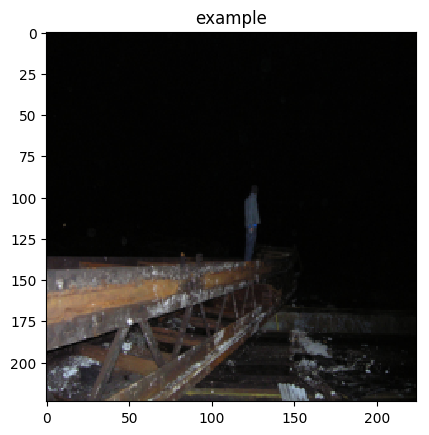

[3, 224, 224]
Tensor(shape=[16], dtype=int64, place=CUDAPlace(0), stop_gradient=True,
       [1 , 6 , 86, 4 , 69, 72, 700, 9 , 6 , 221, 213, 4 , 13, 93, 5 , 2 ])


In [9]:
# 测试一下
dataset=MyDataset(root_dir='./flickr30k-images/',flickr_file='./flickr30k/results_20130124.token',transform=transform)
image,caption=dataset[100]
def show_image(ts, title=None):
    # C*H*W -> H*W*C
    ts = ts.numpy().transpose((1, 2, 0))
    plt.imshow(ts)
    if title is not None:
        plt.title(title)
    plt.show()
show_image(image,'example')
print(image.shape)
print(caption)

In [ ]:
# 上图原有的caption
print([dataset.vocabulary.itos[i] for i in caption.tolist()])

['<SOS>', 'a', 'person', 'in', 'gray', 'stands', 'alone', 'on', 'a', 'structure', 'outdoors', 'in', 'the', 'dark', '.', '<EOS>']


In [ ]:
print(len(dataset.vocabulary))

7667


In [10]:
# padding处理长度
from functools import partial
def Collate_fn(batch_data,pad_val=0, max_seq_len=64):
    seqs, seq_lens= [], []
    max_len = 0
    for seq in batch_data:
        # 对数据序列进行截断
        seq = seq[:max_seq_len]
        # 对数据截断并保存于seqs中
        seqs.append(seq)
        seq_lens.append(len(seq))
        # 保存序列最大长度
        max_len = max(max_len, len(seq))
    # 对数据序列进行填充至最大长度
    padding=paddle.full(shape=[len(seqs),max_len],fill_value=pad_val,dtype='int64')
    for i in range(len(seqs)):
        padding[i,:seq_lens[i]]=seqs[i].reshape([-1])
    return padding
def CapCollate(batch_data,pad_val=0,max_seq_len=64):
    images = [item[0].unsqueeze(0) for item in batch_data]
    images = paddle.concat(images,0)
    targets = [item[1] for item in batch_data]
    targets = Collate_fn(targets, pad_val=pad_val)
    return images,targets

In [11]:
dataloader=DataLoader(dataset=dataset,batch_size=128,shuffle=True,collate_fn=CapCollate)

In [ ]:
print(len(dataloader))

1242


In [ ]:
# 打个例子
for i,(data,target) in enumerate(dataloader):
    if i==0:
        print(data.shape,target.shape)
        break

[128, 3, 224, 224] [128, 41]


### 3.The net model

In [12]:
token_dir='./flickr30k/results_20130124.token'
images_dir='./flickr30k-images/'
# 设置CUDA训练
PLACE = paddle.CUDAPlace(0)
print(paddle.device.get_device())
paddle.device.set_device('gpu:0')

gpu:0


CUDAPlace(0)

In [13]:
import paddle.nn as nn
import paddle.nn.functional as F
import paddle.vision.models as models
# CNN
class encoder(nn.Layer):
    def __init__(self):
        super(encoder,self).__init__()
        # 残差网络
        resnet=models.resnet50(pretrained=True)
        # 各层结构
        resnet_children=list(resnet.children())[:-2]
        self.resnet=nn.Sequential(*resnet_children)
    def forward(self,images):
        features=self.resnet(images)
        # 去掉最后一层的平均池化后，resnet得到的结果是batch_size*2048*7*7
        # 2048是channel，7 7是hight width
        # 调换维度，对应torch的permute
        features=paddle.transpose(features,perm=[0,2,3,1])
        features=features.reshape([features.shape[0],-1,2048])
        return features

#加性模型Bahdanau attention
class attention(nn.Layer):
    def __init__(self,encoder_dim,decoder_dim,attention_dim):
        super(attention,self).__init__()
        self.encoder_dim=encoder_dim
        self.decoder_dim=decoder_dim
        self.attention_dim=attention_dim
        self.W1=nn.Linear(decoder_dim,attention_dim)
        self.W2=nn.Linear(encoder_dim,attention_dim)
        self.A=nn.Linear(attention_dim,1)
    def forward(self,features,hidden_state):        
        combined_states = paddle.tanh(self.W2(features) + self.W1(hidden_state).unsqueeze(1)) #(batch_size,num_layers,attemtion_dim)
        scores = self.A(combined_states).squeeze(2)         #(batch_size,num_layers)       
        alpha = F.softmax(scores)          #(batch_size,num_layers)
        
        att_results = features * alpha.unsqueeze(2)  #(batch_size,num_layers,features_dim)
        att_results = att_results.sum(axis=1)   #(batch_size,num_layers)
        return alpha,att_results

In [14]:
# RNN
class decoder(nn.Layer):
    def __init__(self,embed_dim, vocab_size, encoder_dim,attention_dim,decoder_dim,drop_prob=0.25):
        super().__init__()
        self.embed_dim=embed_dim
        self.vocab_size = vocab_size
        self.attention_dim = attention_dim
        self.encoder_dim=encoder_dim
        self.decoder_dim = decoder_dim
        
        self.embedding = nn.Embedding(vocab_size,embed_dim)
        self.attention = attention(encoder_dim,decoder_dim,attention_dim)
        
        self.init_h = nn.Linear(encoder_dim, decoder_dim)  
        self.init_c = nn.Linear(encoder_dim, decoder_dim)  
        self.lstm_cell = nn.LSTMCell(embed_dim+encoder_dim,decoder_dim)
        self.f_beta = nn.Linear(decoder_dim, encoder_dim)
        
        self.fcn = nn.Linear(decoder_dim,vocab_size)
        self.drop = nn.Dropout(drop_prob)    

    def init_hidden_state(self, features):
        mean_encoder_out = features.mean(axis=1)   #(batch_size, encoder_dim)
        h = self.init_h(mean_encoder_out)  # (batch_size, decoder_dim)
        c = self.init_c(mean_encoder_out)
        return h, c    

    def forward(self, features, captions):
        embeds = self.embedding(captions)    # batch_size,seq_lenth,embedding_len
        mean_encoder_out = features.mean(axis=1)   #(batch_size, encoder_dim)
        h = self.init_h(mean_encoder_out)  # (batch_size, decoder_dim)
        c = self.init_c(mean_encoder_out)
        #去掉句号
        seq_length = len(captions[0])-1 
        batch_size,num_features = features.shape[0],features.shape[1]
        
        preds = paddle.zeros(shape=[batch_size, seq_length, self.vocab_size],dtype='float32')
        alphas = paddle.zeros(shape=[batch_size, seq_length,num_features],dtype='float32')
                
        for s in range(seq_length):
            alpha,context = self.attention(features, h)
            lstm_input = paddle.concat((embeds[:, s], context), axis=1)
            y,(h, c) = self.lstm_cell(lstm_input, (h, c))
                    
            output = self.fcn(self.drop(h))   # (batch_size,vocab_size)
            
            preds[:,s] = output     # batch_size,vocab_size,seq_len
            alphas[:,s] = alpha       
        return preds, alphas
    
    def generate_caption(self,features,max_len=32,vocab=None):
        
        batch_size = features.shape[0]
        mean_encoder_out = features.mean(axis=1)   #(batch_size, encoder_dim)
        h = self.init_h(mean_encoder_out)  # (batch_size, decoder_dim)
        c = self.init_c(mean_encoder_out)
        
        alphas = []
        
        #starting input
        word=paddle.to_tensor(vocab.stoi['<SOS>'],place=PLACE).reshape([1,-1])
        embeds = self.embedding(word)
        captions = []
        
        for i in range(max_len):
            alpha,context = self.attention(features, h)
                 
            #store the apla score
            alphas.append(alpha.numpy())
            
            lstm_input = paddle.concat((embeds[:, 0], context), axis=1)
            y,(h, c) = self.lstm_cell(lstm_input, (h, c))
            output = self.fcn(self.drop(h))   #batch_size,vocab_size
            #output = output.reshape(batch_size,-1)  #batch_size,vocab_size
        
            predicted_word_idx = output.argmax(axis=1)
            
            captions.append(predicted_word_idx.item())

            if vocab.itos[predicted_word_idx.item()] == "<EOS>":
                break
            # 更新这一时刻的变量，用在下一时刻
            embeds = self.embedding(predicted_word_idx.unsqueeze(0))

        return [vocab.itos[idx] for idx in captions],alphas
    

In [15]:
# 汇总网络
class model_image_caption(nn.Layer):
    def __init__(self,embedding_size,vocab_size,encoder_dim,attention_dim,decoder_dim,drop_prob=0.25):
        super().__init__()
        self.encoder=encoder()
        self.decoder=decoder(embedding_size,vocab_size,encoder_dim,attention_dim,decoder_dim,drop_prob)
    def forward(self,datasets):
        images,captions=datasets
        features=self.encoder(images)
        outputs=self.decoder(features,captions)
        return outputs

### 4.Train

In [16]:
from paddle.metric import Metric
class Accuracy(Metric):
    def __init__(self, is_logist=True):
        """
        输入：
           - is_logist: outputs是logits还是激活后的值
        """

        # 用于统计正确的样本个数
        self.num_correct = 0
        # 用于统计样本的总数
        self.num_count = 0

        self.is_logits = is_logist

    def reset(self):
        self.num_correct = 0
        self.num_count = 0

    def name(self):
        return "Accuracy"
    def update(self, outputs, labels):
        """
        输入：
           - outputs: 预测值, shape=[N,class_num]
           - labels: 标签值, shape=[N,1]
        """

        #判断是二分类任务还是多分类任务，shape[1]=1时为二分类任务，shape[1]>1时为多分类任务
        if outputs.shape[1] == 1:
            if self.is_logist:
                # logits判断是否大于0
                preds = paddle.cast((outputs>=0), dtype='float32')
            else:
                # 如果不是logits，判断每个概率值是否大于0.5，当大于0.5时，类别为1，否则类别为0
                preds = paddle.cast((outputs>=0.5), dtype='float32')
        else:
            #多分类时，使用'paddle.argmax'计算最大元素索引作为类别
            preds = paddle.argmax(outputs, axis=1, dtype='int64')

        # 获取本批数据中预测正确的样本个数
        labels = paddle.squeeze(labels, axis=-1)
        batch_correct = paddle.sum(paddle.cast(preds==labels, dtype="float32")).numpy()[0]
        batch_count = len(labels)

        # 更新num_correct 和 num_count
        self.num_correct += batch_correct
        self.num_count += batch_count

    def accumulate(self):
        # 使用累计的数据，计算总的指标
        if self.num_count == 0:
            return 0
        return self.num_correct / self.num_count

In [17]:
class RunnerV3(object):
    def __init__(self, model, optimizer, loss_fn, metric, **kwargs):
        self.model = model
        self.optimizer = optimizer
        self.loss_fn = loss_fn
        self.metric = metric #只用于计算评价指标

        #记录训练过程中的损失函数变化情况
        self.train_epoch_losses = [] # 一个epoch记录一次loss
        self.train_step_losses = []  # 一个step记录一次loss
        
        #记录全局最优指标
        self.best_loss = 20

    def train(self, train_loader, **kwargs):
        #将模型切换为训练模式
        self.model.train()

        #传入训练轮数，如果没有传入值则默认为0
        num_epochs = kwargs.get("num_epochs", 0)
        #传入log打印频率，如果没有传入值则默认为100
        log_steps = kwargs.get("log_steps", 100)
        # 评价频率
        draw_steps = kwargs.get("draw_steps", 300)

        #传入模型保存路径，如果没有传入值则默认为"best_model.pdparams"
        save_path = kwargs.get("save_path", "best_model.pdparams")

        custom_print_log = kwargs.get("custom_print_log", None) 
       
        # 训练总的步数
        num_training_steps = num_epochs * len(train_loader)

            
        # 运行的step数目
        global_step = 0

        #进行num_epochs轮训练
        for epoch in range(num_epochs):
            #用于统计训练集的损失
            total_loss = 0
            for step, data in enumerate(train_loader):
                X, y = data
                #print(y)
                #获取模型预测
                outputs,attentions = self.model((X,y))
                targets=y[:,1:]
                loss = self.loss_fn(outputs.reshape([-1,vocab_size]),targets.reshape([-1])) # 默认求mean
                total_loss += loss 

                # 训练过程中，每个step的loss进行保存
                self.train_step_losses.append((global_step,loss.item()))

                if log_steps and global_step%log_steps==0:
                    print(f"[Train] epoch: {epoch}/{num_epochs}, step: {global_step}/{num_training_steps}, loss: {loss.item():.5f}")
                    if global_step%draw_steps==0:
                        self.model.eval()
                        with paddle.no_grad():
                            dataiter = iter(train_loader)
                            img,_ = next(dataiter)
                            features = self.model.encoder(img[0:1])
                            caps,alphas = self.model.decoder.generate_caption(features,vocab=dataset.vocabulary)
                            caption = ' '.join(caps)
                            #print(caption)
                            show_image(img[0],title=caption)
                
                        self.model.train()


                # 梯度反向传播，计算每个参数的梯度值
                loss.backward() 

                if custom_print_log:
                   custom_print_log(self)
                
                # 小批量梯度下降进行参数更新
                self.optimizer.step()
                # 梯度归零
                self.optimizer.clear_grad()

                # if loss<self.best_loss:
                #     self.save_model(save_path)
                #     #print(loss)
                #     #print(self.best_loss)
                #     #print(f"[Evaluate] best accuracy performence has been updated: {(self.best_loss):.5f} --> {loss.item():.5f}")
                #     self.best_loss=loss

                self.save_model(save_path)
                global_step += 1
            
            # 当前epoch 训练loss累计值 
            trn_loss = (total_loss/len(train_loader)).item()
            # epoch粒度的训练loss保存
            self.train_epoch_losses.append(trn_loss)
            
        print("[Train] Training done!")

    #模型评估阶段，使用'paddle.no_grad()'控制不计算和存储梯度
    @paddle.no_grad()
    def evaluate(self, dev_loader, **kwargs):
        assert self.metric is not None

        #将模型设置为评估模式
        self.model.eval()

        global_step = kwargs.get("global_step", -1) 

        #用于统计训练集的损失
        total_loss = 0

        # 重置评价
        self.metric.reset() 
        
        # 遍历验证集每个批次    
        for batch_id, data in enumerate(dev_loader):
            X, y = data
            outputs,attentions = self.model(X,y)
            targets=captions[:,1:]
            loss = self.loss_fn(outputs.reshape(-1,vocab_size),targets.reshape(-1)).item() # 默认求mean
            total_loss += loss 


        dev_loss = (total_loss/len(dev_loader))
        self.dev_losses.append((global_step, dev_loss))

        return dev_loss
    

    def save_model(self, save_path):
        paddle.save(self.model.state_dict(), save_path)

    def load_model(self, model_path):
        model_state_dict = paddle.load(model_path)
        self.model.set_state_dict(model_state_dict)

100%|██████████| 151272/151272 [00:02<00:00, 66564.42it/s]
/opt/conda/envs/python35-paddle120-env/lib/python3.7/site-packages/paddle/nn/layer/norm.py:653: UserWarning: When training, we now always track global mean and variance.
  "When training, we now always track global mean and variance.")


[Train] epoch: 0/3, step: 0/3726, loss: 8.93170


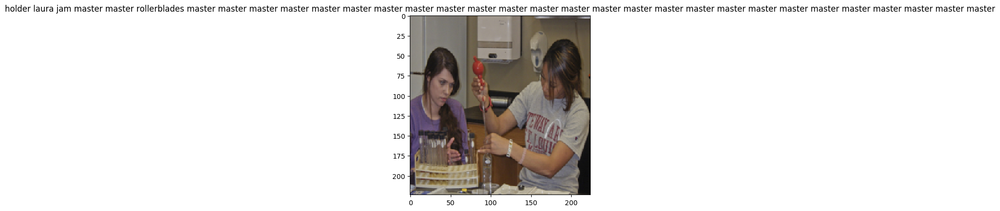

[Train] epoch: 0/3, step: 50/3726, loss: 2.73582
[Train] epoch: 0/3, step: 100/3726, loss: 3.13373


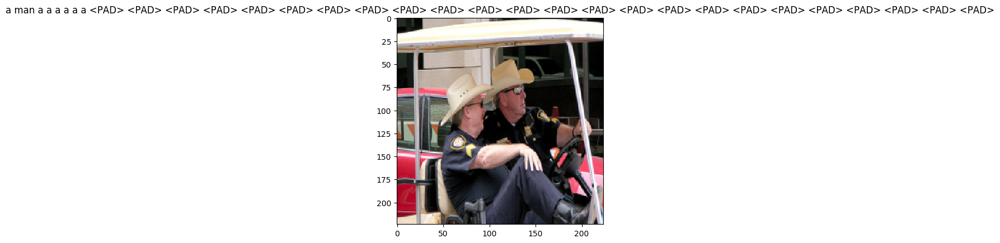

[Train] epoch: 0/3, step: 150/3726, loss: 3.07387
[Train] epoch: 0/3, step: 200/3726, loss: 2.47533


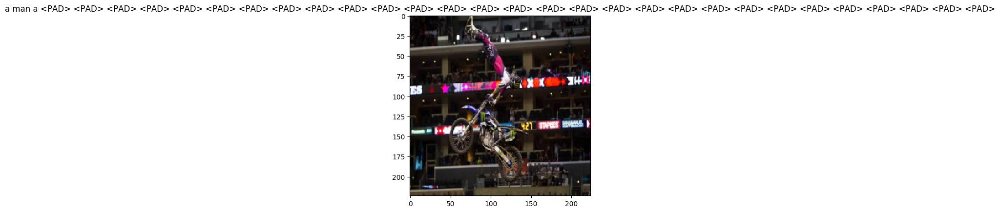

[Train] epoch: 0/3, step: 250/3726, loss: 2.41601
[Train] epoch: 0/3, step: 300/3726, loss: 1.77794


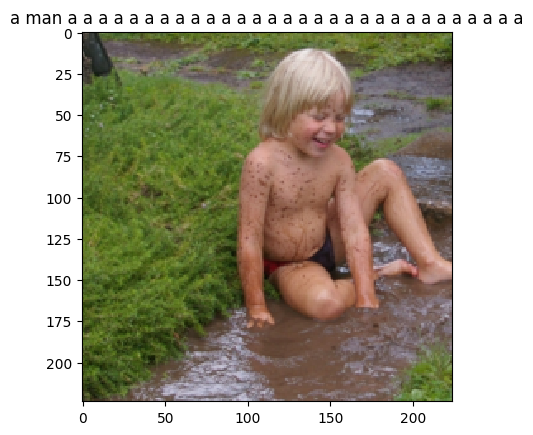

[Train] epoch: 0/3, step: 350/3726, loss: 2.12401
[Train] epoch: 0/3, step: 400/3726, loss: 2.16962


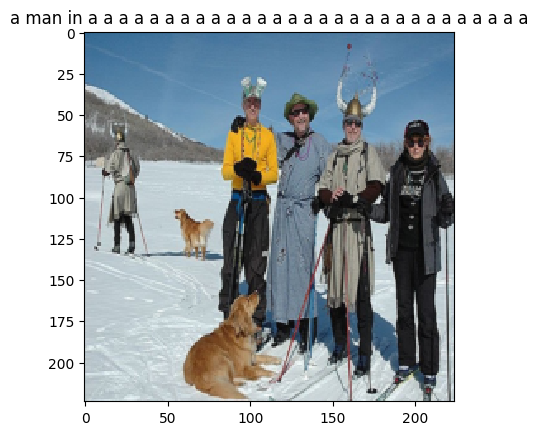

[Train] epoch: 0/3, step: 450/3726, loss: 2.00972
[Train] epoch: 0/3, step: 500/3726, loss: 1.83847


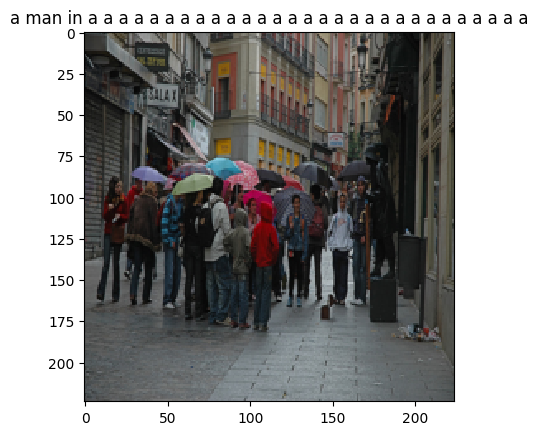

[Train] epoch: 0/3, step: 550/3726, loss: 1.46385
[Train] epoch: 0/3, step: 600/3726, loss: 1.63725


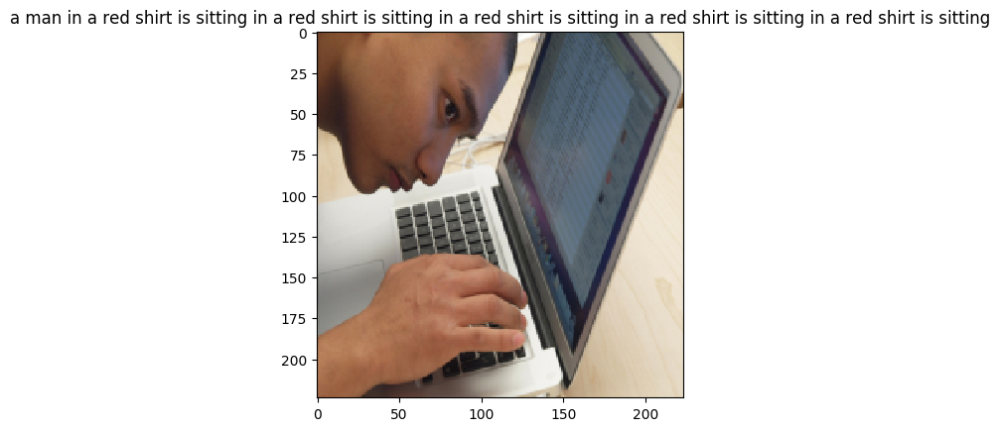

[Train] epoch: 0/3, step: 650/3726, loss: 1.39997
[Train] epoch: 0/3, step: 700/3726, loss: 1.65986


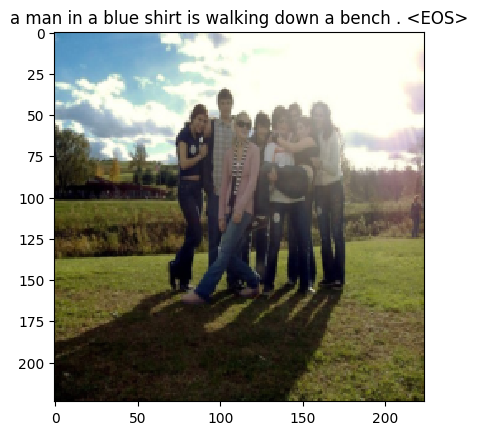

[Train] epoch: 0/3, step: 750/3726, loss: 1.39418
[Train] epoch: 0/3, step: 800/3726, loss: 1.53768


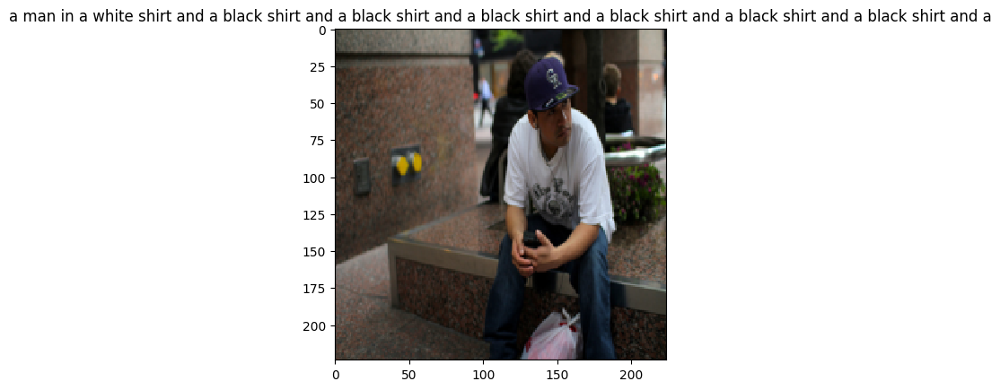

[Train] epoch: 0/3, step: 850/3726, loss: 1.12940
[Train] epoch: 0/3, step: 900/3726, loss: 1.48188


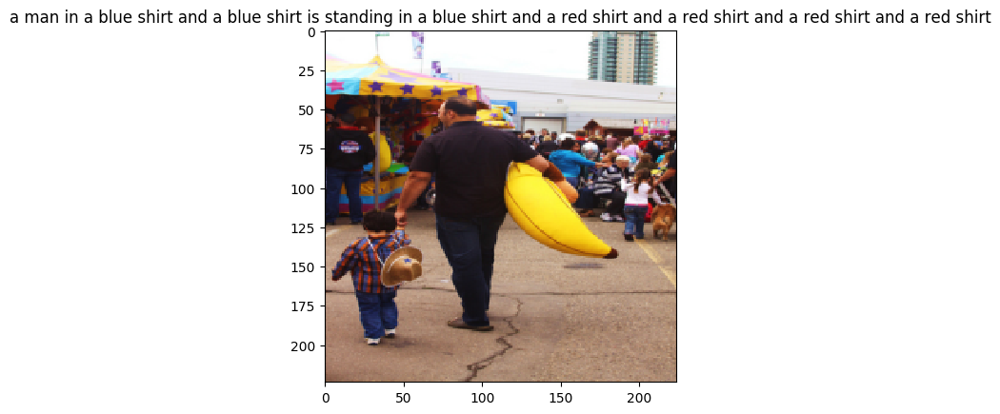

[Train] epoch: 0/3, step: 950/3726, loss: 1.66159
[Train] epoch: 0/3, step: 1000/3726, loss: 1.81065


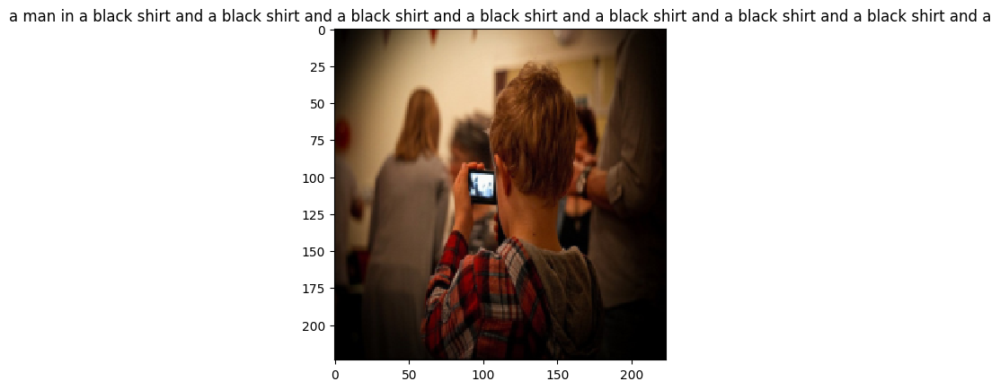

[Train] epoch: 0/3, step: 1050/3726, loss: 1.09223
[Train] epoch: 0/3, step: 1100/3726, loss: 1.11797


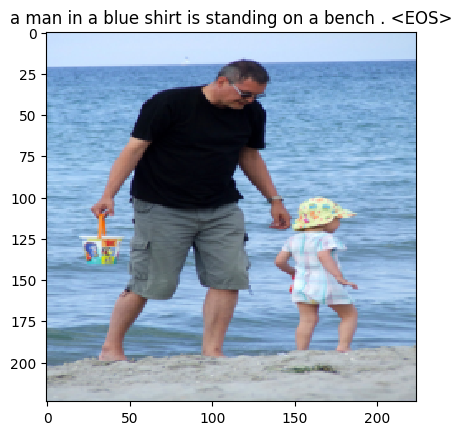

[Train] epoch: 0/3, step: 1150/3726, loss: 1.54402
[Train] epoch: 0/3, step: 1200/3726, loss: 1.52653


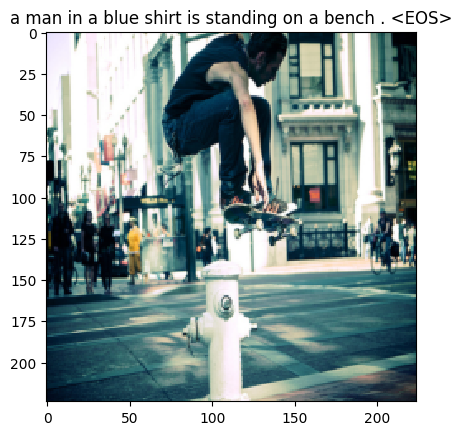

[Train] epoch: 1/3, step: 1250/3726, loss: 1.80479
[Train] epoch: 1/3, step: 1300/3726, loss: 1.34427


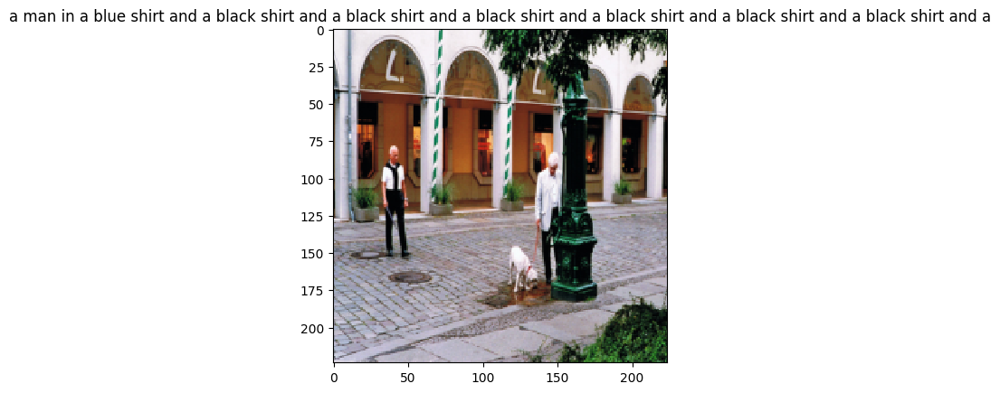

[Train] epoch: 1/3, step: 1400/3726, loss: 1.43459


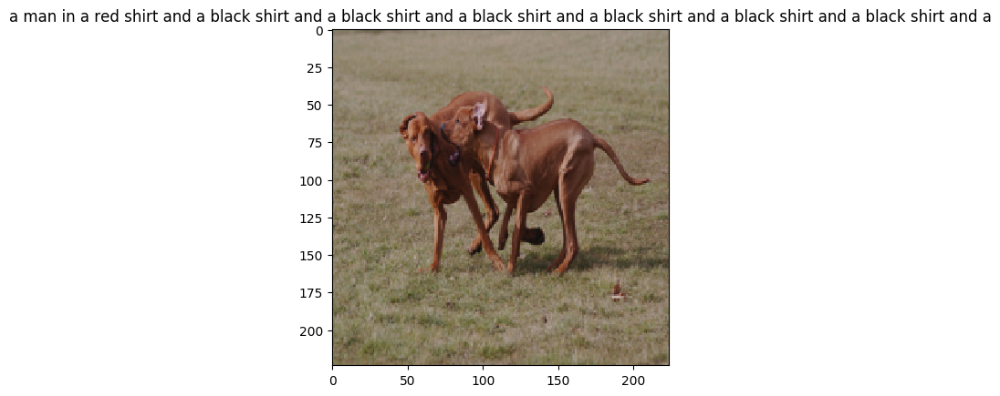

[Train] epoch: 1/3, step: 1450/3726, loss: 1.20303
[Train] epoch: 1/3, step: 1500/3726, loss: 1.42594


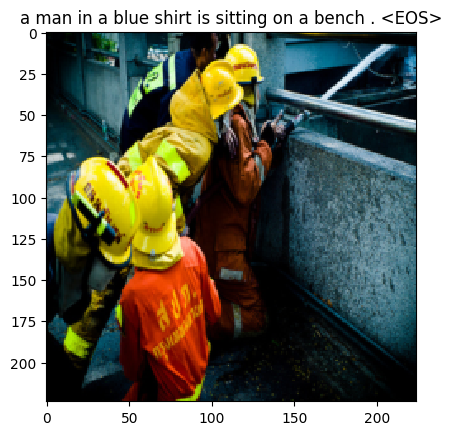

[Train] epoch: 1/3, step: 1550/3726, loss: 1.46889
[Train] epoch: 1/3, step: 1600/3726, loss: 1.51524


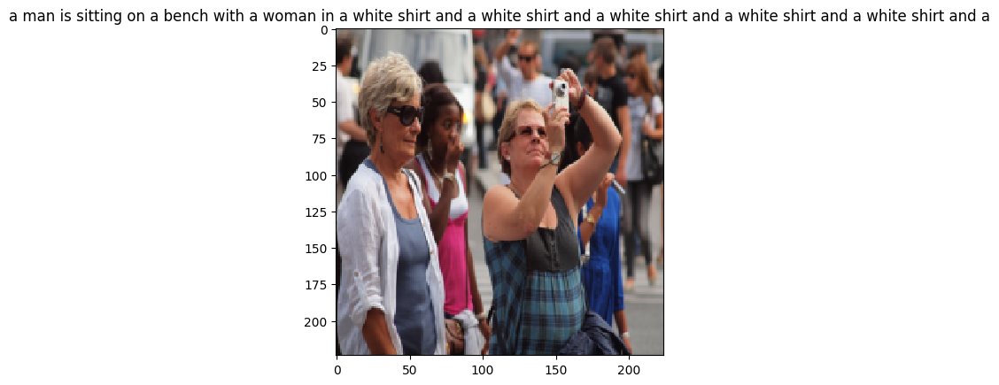

[Train] epoch: 1/3, step: 1650/3726, loss: 1.04152
[Train] epoch: 1/3, step: 1700/3726, loss: 1.11873


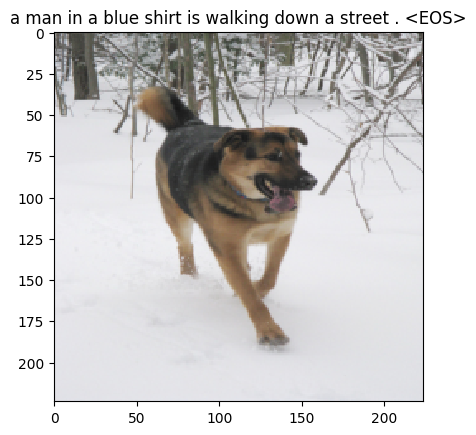

[Train] epoch: 1/3, step: 1750/3726, loss: 1.34780
[Train] epoch: 1/3, step: 1800/3726, loss: 0.89675


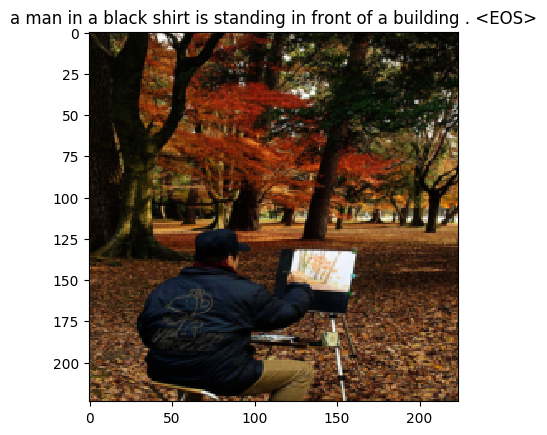

[Train] epoch: 1/3, step: 1850/3726, loss: 1.19137
[Train] epoch: 1/3, step: 1900/3726, loss: 1.51508


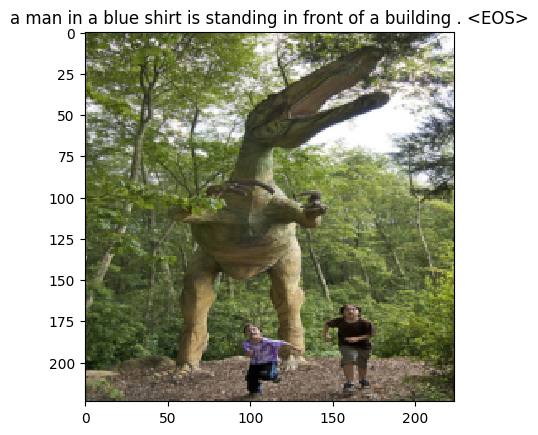

[Train] epoch: 1/3, step: 1950/3726, loss: 1.08757
[Train] epoch: 1/3, step: 2000/3726, loss: 1.24423


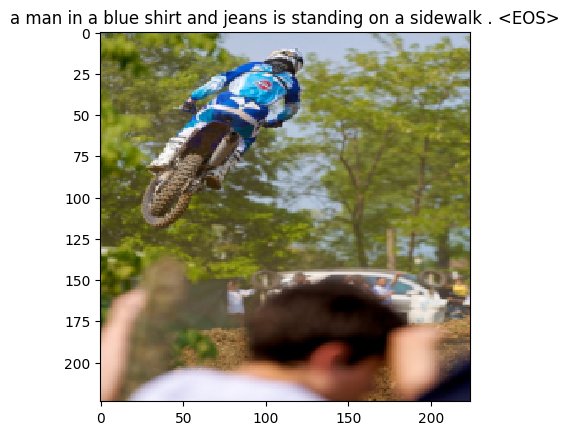

[Train] epoch: 1/3, step: 2050/3726, loss: 1.20428
[Train] epoch: 1/3, step: 2100/3726, loss: 1.59363


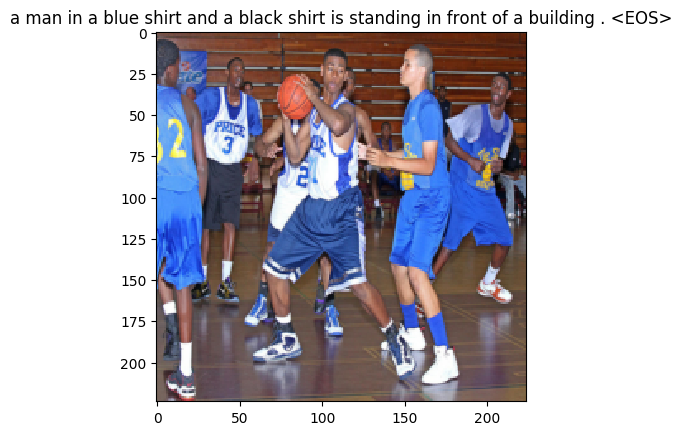

[Train] epoch: 1/3, step: 2150/3726, loss: 1.39416
[Train] epoch: 1/3, step: 2200/3726, loss: 1.01734


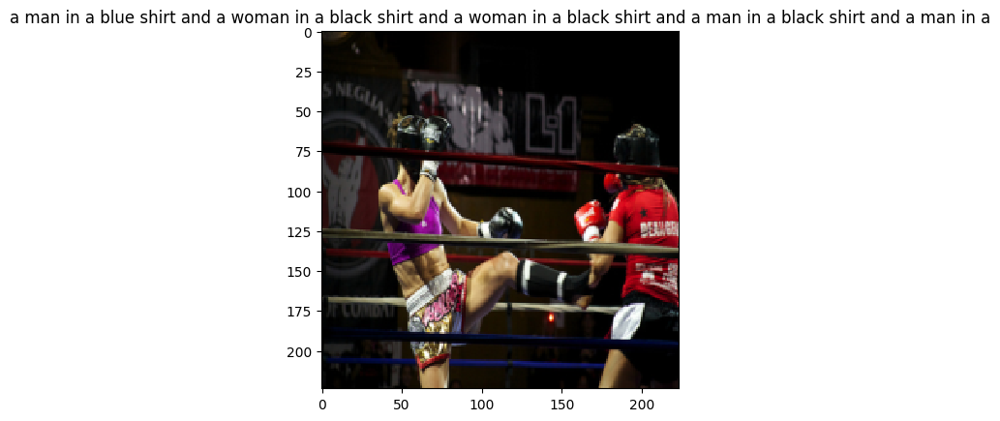

[Train] epoch: 1/3, step: 2250/3726, loss: 1.72965
[Train] epoch: 1/3, step: 2300/3726, loss: 1.28656


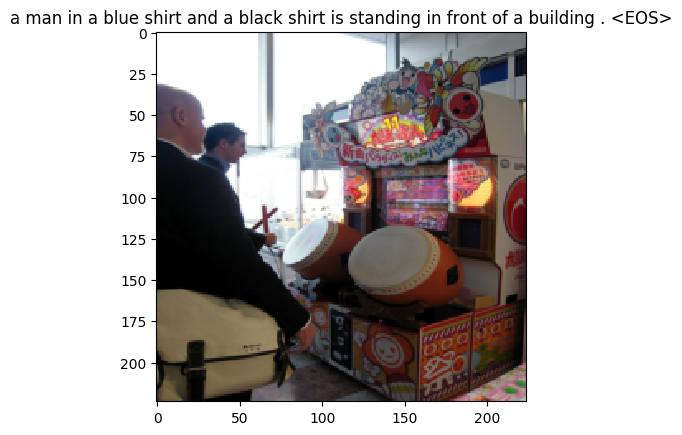

[Train] epoch: 1/3, step: 2350/3726, loss: 1.20714
[Train] epoch: 1/3, step: 2400/3726, loss: 1.26016


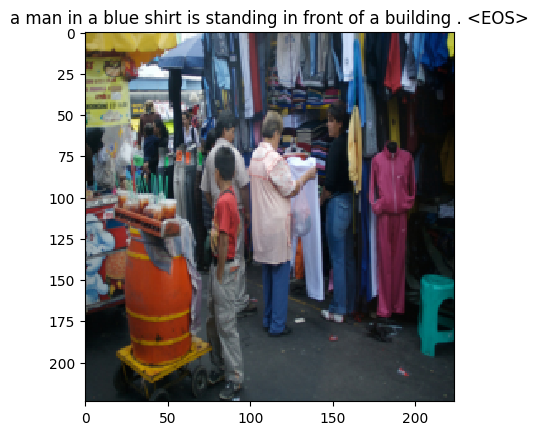

[Train] epoch: 1/3, step: 2450/3726, loss: 1.49612
[Train] epoch: 2/3, step: 2500/3726, loss: 1.42813


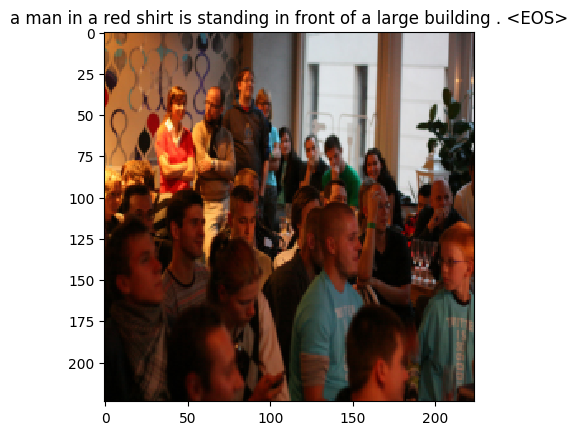

[Train] epoch: 2/3, step: 2550/3726, loss: 1.58669
[Train] epoch: 2/3, step: 2600/3726, loss: 1.25818


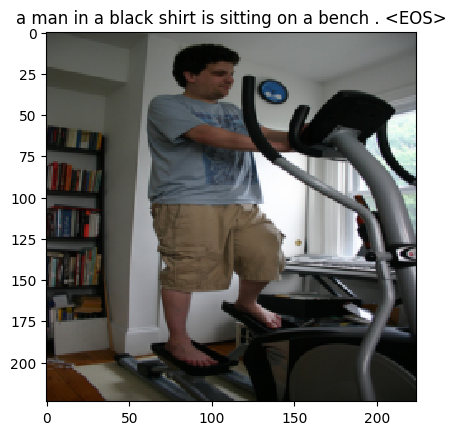

[Train] epoch: 2/3, step: 2650/3726, loss: 1.43392
[Train] epoch: 2/3, step: 2700/3726, loss: 1.18148


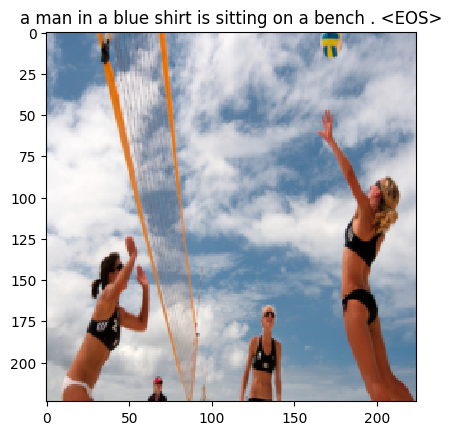

[Train] epoch: 2/3, step: 2750/3726, loss: 1.40905
[Train] epoch: 2/3, step: 2800/3726, loss: 1.31226


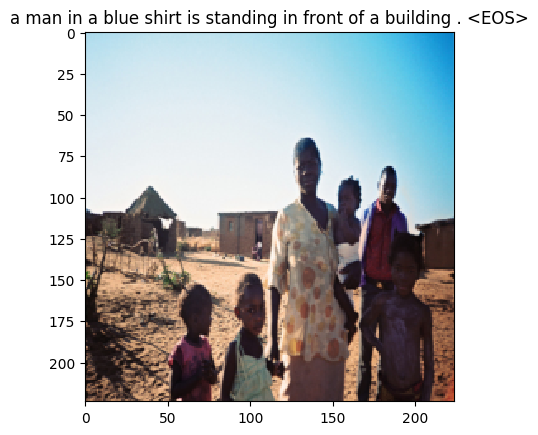

[Train] epoch: 2/3, step: 2850/3726, loss: 1.46900
[Train] epoch: 2/3, step: 2900/3726, loss: 1.34203


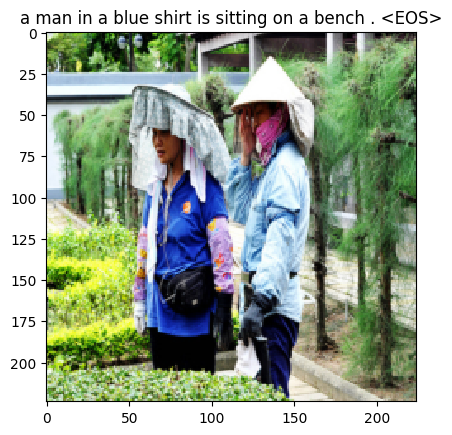

[Train] epoch: 2/3, step: 2950/3726, loss: 1.24040
[Train] epoch: 2/3, step: 3000/3726, loss: 1.27462


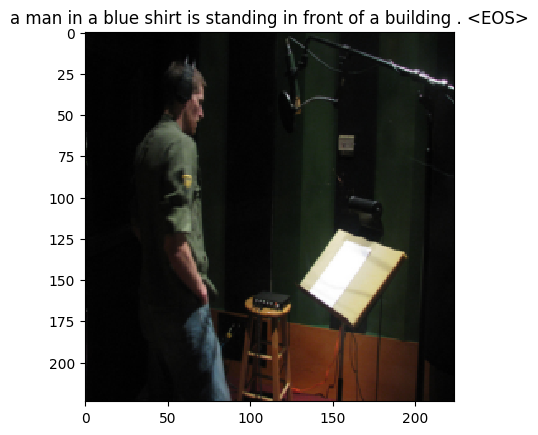

[Train] epoch: 2/3, step: 3050/3726, loss: 1.51738
[Train] epoch: 2/3, step: 3100/3726, loss: 1.45971


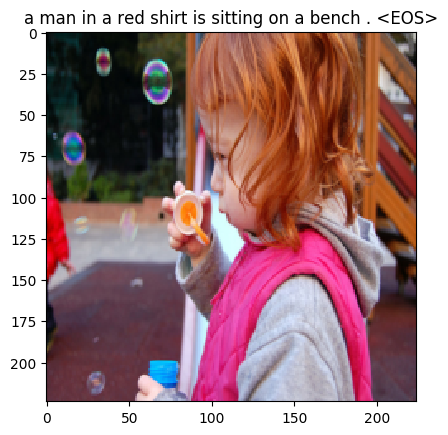

[Train] epoch: 2/3, step: 3150/3726, loss: 1.41553
[Train] epoch: 2/3, step: 3200/3726, loss: 1.13749


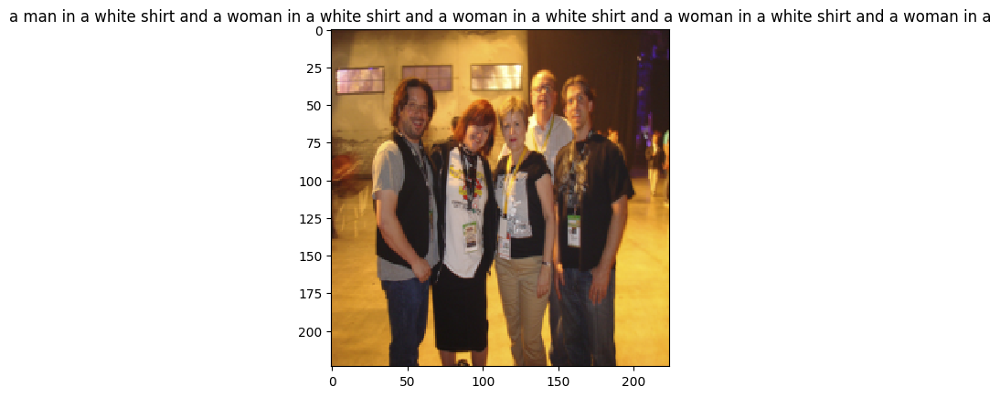

[Train] epoch: 2/3, step: 3250/3726, loss: 1.16750
[Train] epoch: 2/3, step: 3300/3726, loss: 1.30854


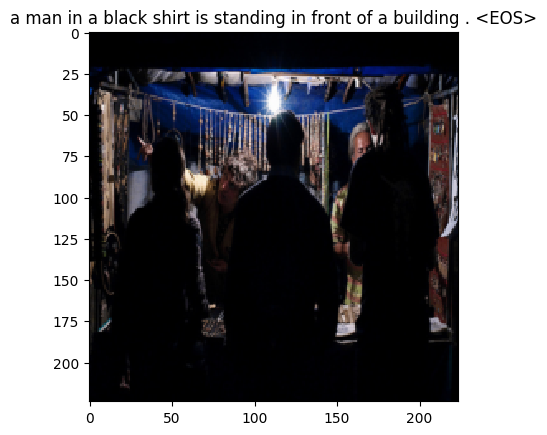

[Train] epoch: 2/3, step: 3350/3726, loss: 0.95294
[Train] epoch: 2/3, step: 3400/3726, loss: 0.87434


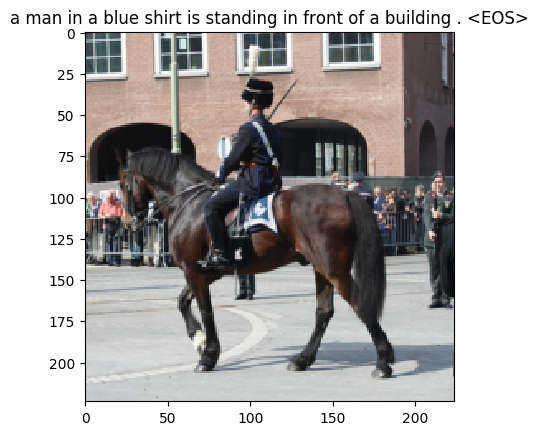

[Train] epoch: 2/3, step: 3450/3726, loss: 0.83828
[Train] epoch: 2/3, step: 3500/3726, loss: 1.29962


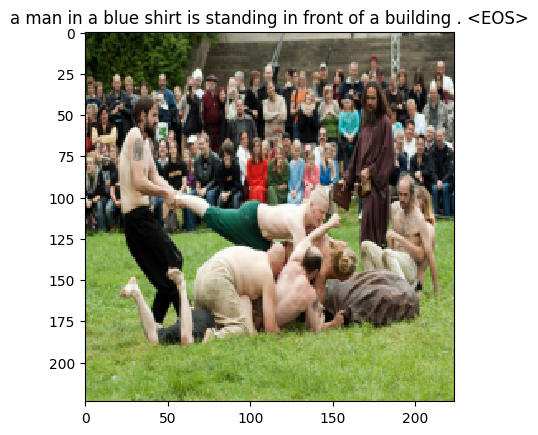

[Train] epoch: 2/3, step: 3550/3726, loss: 1.15257
[Train] epoch: 2/3, step: 3600/3726, loss: 1.14406


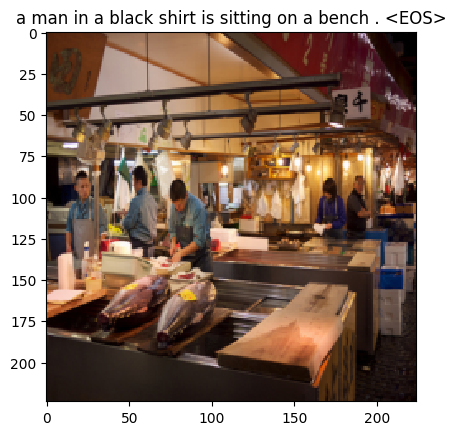

[Train] epoch: 2/3, step: 3650/3726, loss: 1.63842
[Train] epoch: 2/3, step: 3700/3726, loss: 1.39000


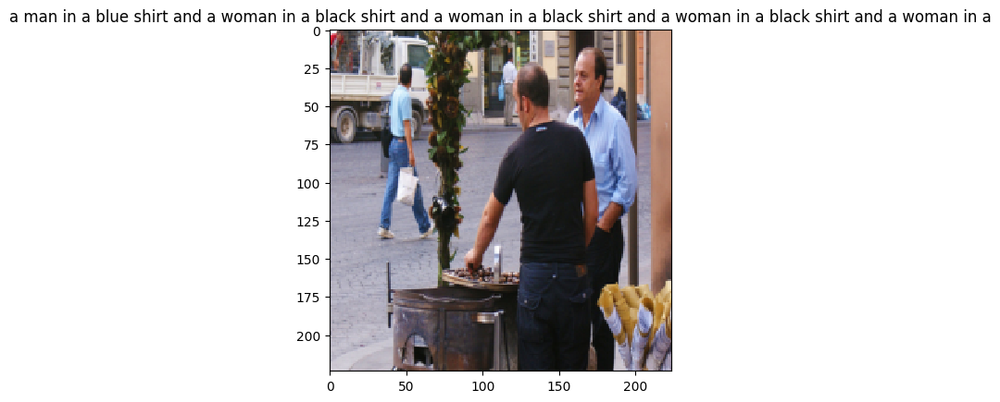

[Train] Training done!


In [ ]:
# 训练
import random
import numpy as np

np.random.seed(102)
random.seed(102)
paddle.seed(102)

# 指定训练轮次
num_epochs = 3
#print('I am here')
embedding_size=64
vocab_size = len(dataset.vocabulary)
attention_dim=128
encoder_dim=2048
decoder_dim=256
learning_rate = 0.01

# 实例化模型
model = model_image_caption(embedding_size,vocab_size,encoder_dim,attention_dim,decoder_dim,drop_prob=0.25)
#print('I am here')
# 指定优化器
optimizer = paddle.optimizer.Adam(learning_rate=learning_rate, beta1=0.9, beta2=0.999, parameters= model.parameters()) 
# 指定损失函数
loss_fn = paddle.nn.CrossEntropyLoss() 
# 指定评估指标
metric = Accuracy()
# 实例化Runner
runner = RunnerV3(model, optimizer, loss_fn, metric)
# 模型训练
runner.train(dataloader,  num_epochs=num_epochs, draw_steps=100, log_steps=50, save_path="./checkpoints_ori/best.pdparams")

In [18]:
# 可视化
import matplotlib.pyplot as plt
def plot_training_loss_acc(runner, fig_name, fig_size=(16, 6), sample_step=10, loss_legend_loc="lower left"):
    plt.figure(figsize=fig_size)

    train_items = runner.train_step_losses[::sample_step]
    train_steps=[x[0] for x in train_items]
    train_losses = [x[1] for x in train_items]

    plt.plot(train_steps, train_losses, color='#e4007f', label="Train loss")
    #绘制坐标轴和图例
    plt.ylabel("loss", fontsize='large')
    plt.xlabel("step", fontsize='large')
    plt.legend(loc=loss_legend_loc, fontsize='x-large')
    
    plt.savefig(fig_name)
    plt.show()

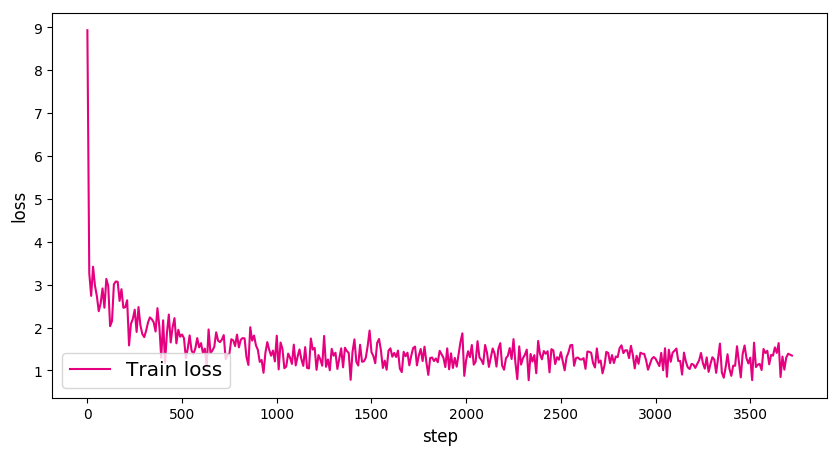

In [ ]:
fig_name = "./caption.pdf"
plot_training_loss_acc(runner, fig_name, fig_size=(10,5), sample_step=10, loss_legend_loc="lower left")

In [ ]:
paddle.device.cuda.empty_cache()

### 5.Improvement

从上面的结果可以看出，模型有些过拟合，几乎将所有的图片主角都认作a man in a xxx shirt is sitting on a bench或者in front of a building，这显然是不合理的。下面我们进行正则化，并提高drop probability。

100%|██████████| 151272/151272 [00:08<00:00, 16841.63it/s]
/opt/conda/envs/python35-paddle120-env/lib/python3.7/site-packages/paddle/tensor/creation.py:130: DeprecationWarning: `np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  if data.dtype == np.object:
/opt/conda/envs/python35-paddle120-env/lib/python3.7/site-packages/paddle/nn/layer/norm.py:653: UserWarning: When training, we now always track global mean and variance.
  "When training, we now always track global mean and variance.")


[Train] epoch: 0/3, step: 0/3726, loss: 8.93187


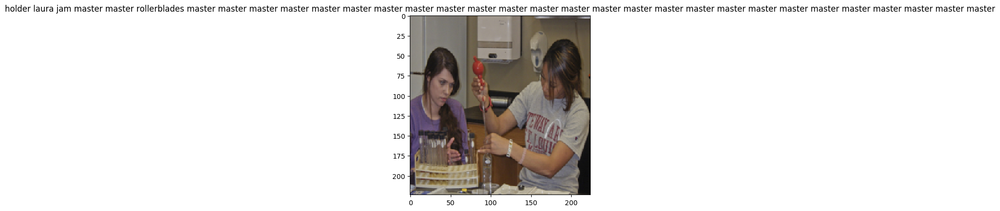

[Train] epoch: 0/3, step: 50/3726, loss: 2.20741
[Train] epoch: 0/3, step: 100/3726, loss: 2.22663


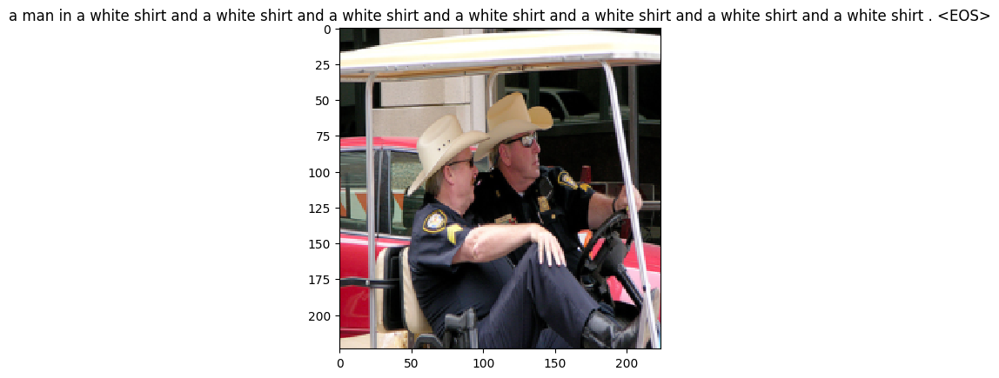

[Train] epoch: 0/3, step: 150/3726, loss: 2.04349
[Train] epoch: 0/3, step: 200/3726, loss: 1.63000


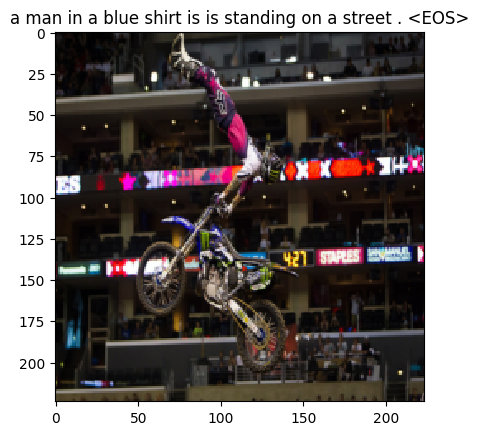

[Train] epoch: 0/3, step: 250/3726, loss: 1.80207
[Train] epoch: 0/3, step: 300/3726, loss: 1.33961


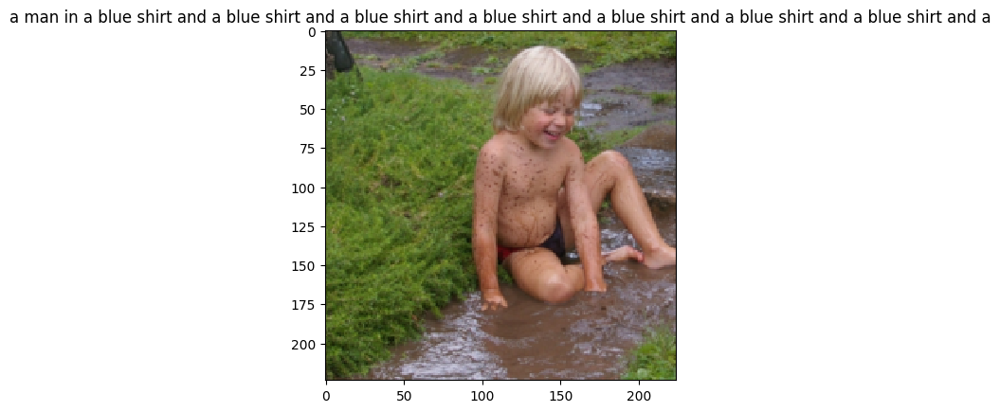

[Train] epoch: 0/3, step: 350/3726, loss: 1.67733
[Train] epoch: 0/3, step: 400/3726, loss: 1.78328


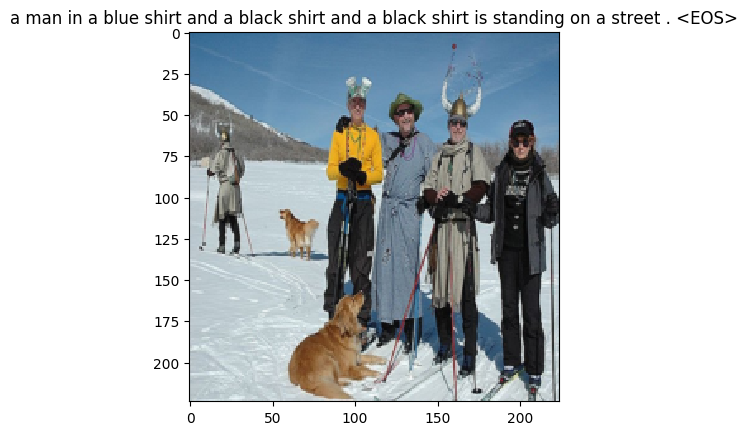

[Train] epoch: 0/3, step: 450/3726, loss: 1.70032
[Train] epoch: 0/3, step: 500/3726, loss: 1.60531


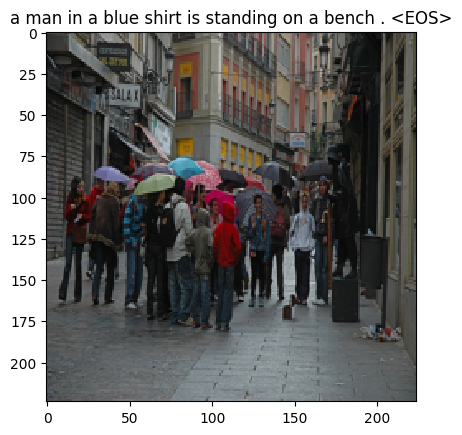

[Train] epoch: 0/3, step: 550/3726, loss: 1.34069
[Train] epoch: 0/3, step: 600/3726, loss: 1.55519


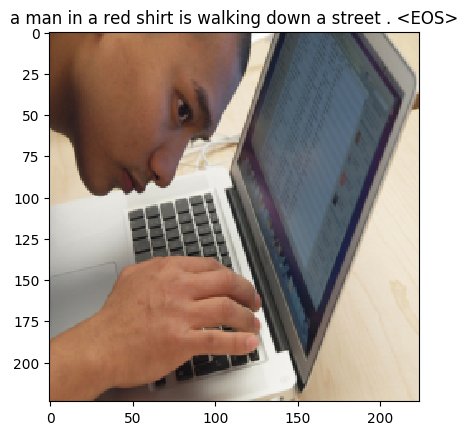

[Train] epoch: 0/3, step: 650/3726, loss: 1.38159
[Train] epoch: 0/3, step: 700/3726, loss: 1.66047


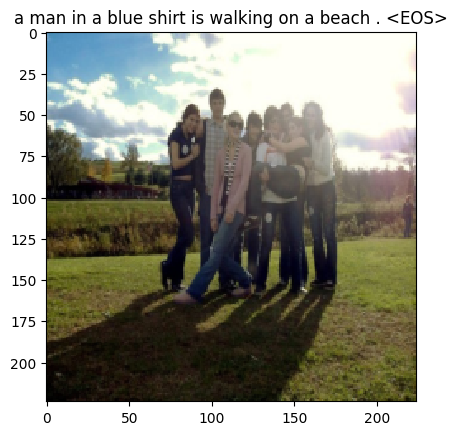

[Train] epoch: 0/3, step: 750/3726, loss: 1.42191
[Train] epoch: 0/3, step: 800/3726, loss: 1.56294


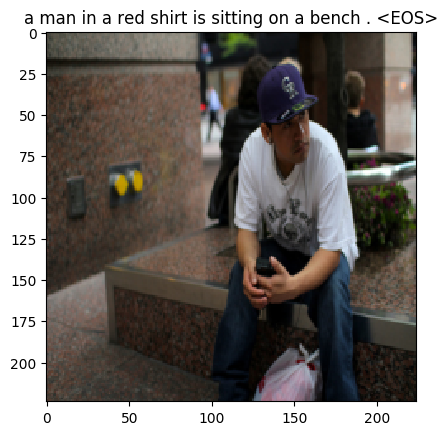

[Train] epoch: 0/3, step: 850/3726, loss: 1.16824
[Train] epoch: 0/3, step: 900/3726, loss: 1.53830


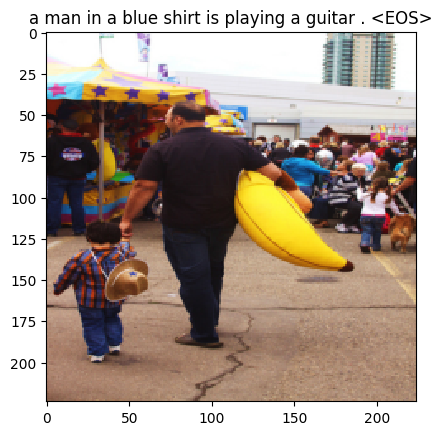

[Train] epoch: 0/3, step: 950/3726, loss: 1.73497
[Train] epoch: 0/3, step: 1000/3726, loss: 1.91758


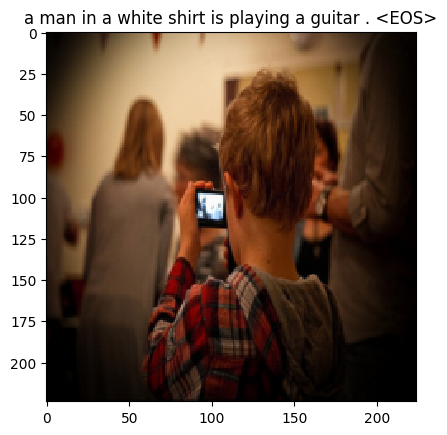

[Train] epoch: 0/3, step: 1050/3726, loss: 1.16875
[Train] epoch: 0/3, step: 1100/3726, loss: 1.21218


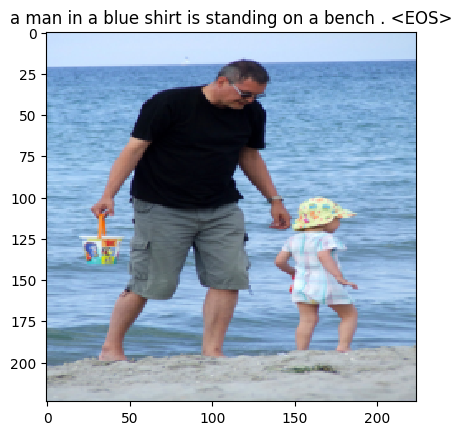

[Train] epoch: 0/3, step: 1150/3726, loss: 1.65580
[Train] epoch: 0/3, step: 1200/3726, loss: 1.65319


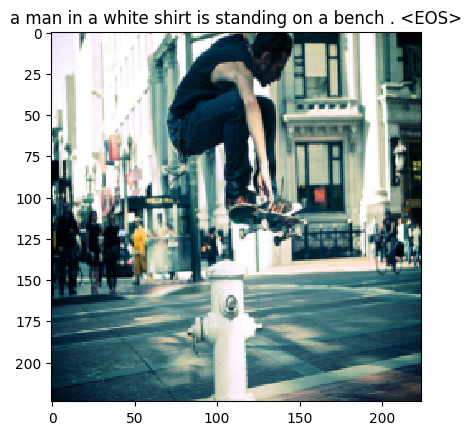

[Train] epoch: 1/3, step: 1250/3726, loss: 1.96564
[Train] epoch: 1/3, step: 1300/3726, loss: 1.49446


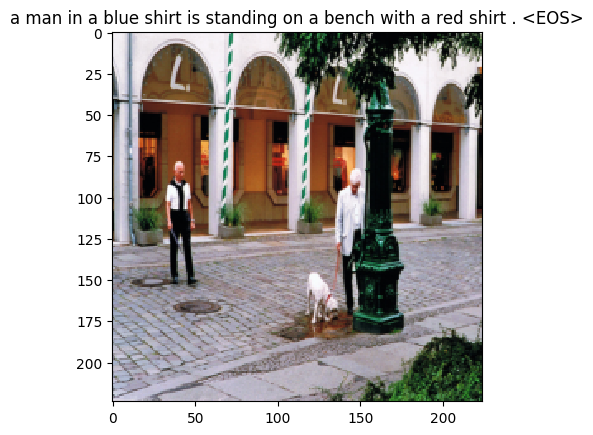

[Train] epoch: 1/3, step: 1350/3726, loss: 1.17880
[Train] epoch: 1/3, step: 1400/3726, loss: 1.60604


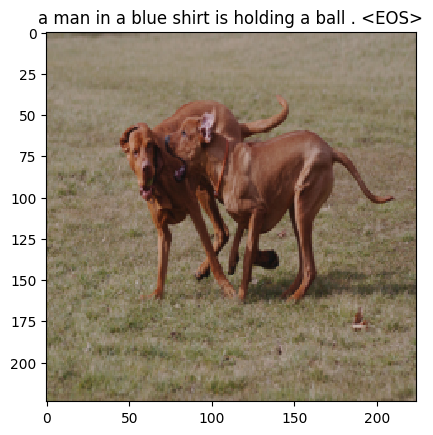

[Train] epoch: 1/3, step: 1450/3726, loss: 1.32498
[Train] epoch: 1/3, step: 1500/3726, loss: 1.60196


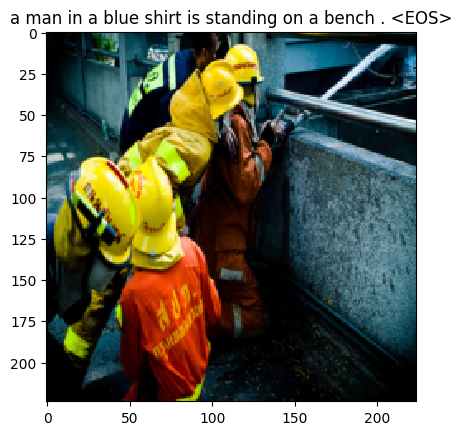

[Train] epoch: 1/3, step: 1550/3726, loss: 1.64158
[Train] epoch: 1/3, step: 1600/3726, loss: 1.70484


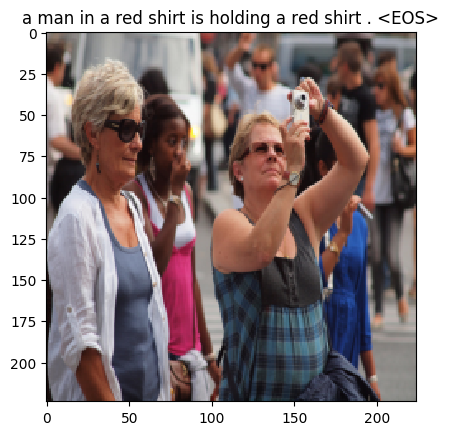

[Train] epoch: 1/3, step: 1650/3726, loss: 1.17804
[Train] epoch: 1/3, step: 1700/3726, loss: 1.26025


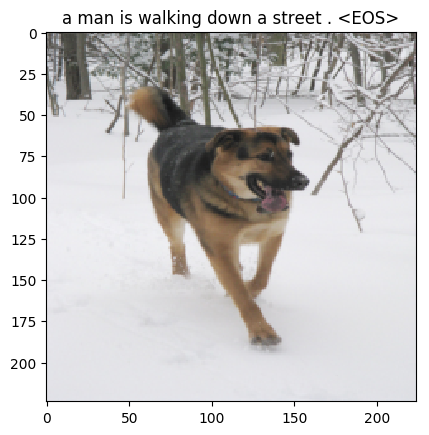

[Train] epoch: 1/3, step: 1750/3726, loss: 1.50047
[Train] epoch: 1/3, step: 1800/3726, loss: 1.02052


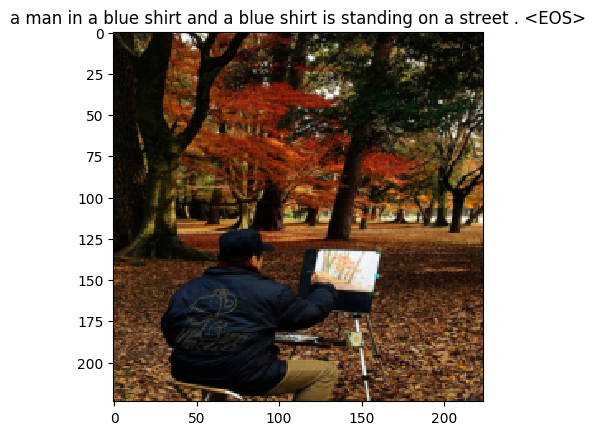

[Train] epoch: 1/3, step: 1850/3726, loss: 1.36242
[Train] epoch: 1/3, step: 1900/3726, loss: 1.71755


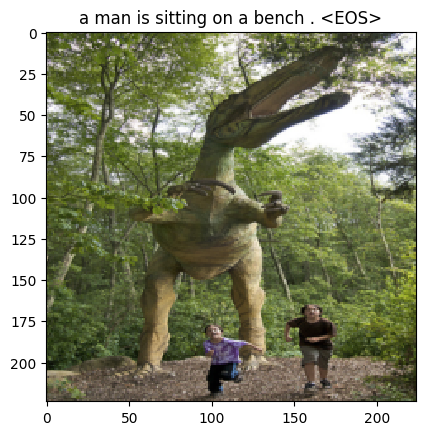

[Train] epoch: 1/3, step: 1950/3726, loss: 1.23983
[Train] epoch: 1/3, step: 2000/3726, loss: 1.42465


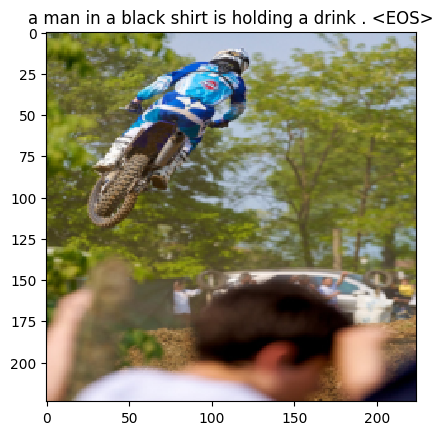

[Train] epoch: 1/3, step: 2050/3726, loss: 1.36381
[Train] epoch: 1/3, step: 2100/3726, loss: 1.82935


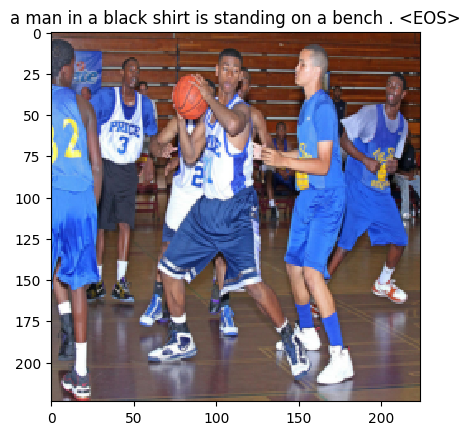

[Train] epoch: 1/3, step: 2150/3726, loss: 1.60890
[Train] epoch: 1/3, step: 2200/3726, loss: 1.16137


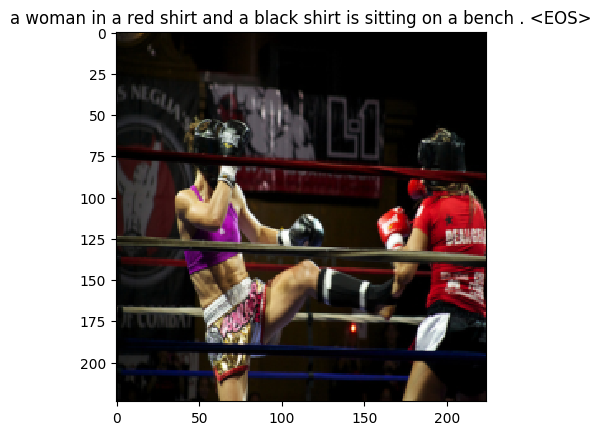

[Train] epoch: 1/3, step: 2250/3726, loss: 1.98263
[Train] epoch: 1/3, step: 2300/3726, loss: 1.49156


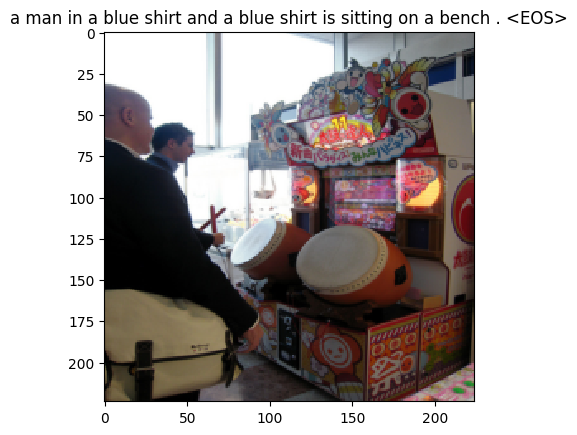

[Train] epoch: 1/3, step: 2350/3726, loss: 1.38167
[Train] epoch: 1/3, step: 2400/3726, loss: 1.45605


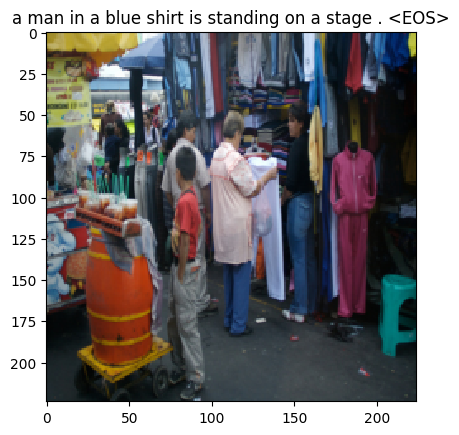

[Train] epoch: 1/3, step: 2450/3726, loss: 1.71818
[Train] epoch: 2/3, step: 2500/3726, loss: 1.69540


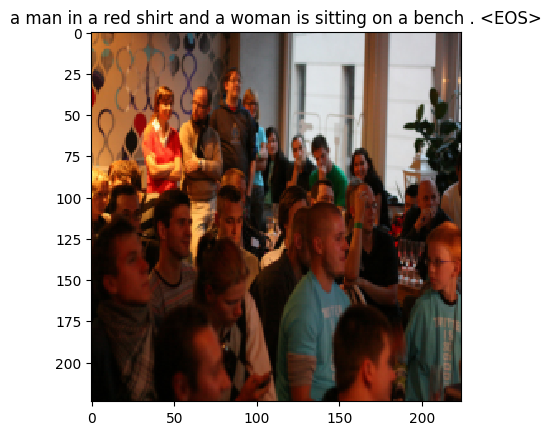

[Train] epoch: 2/3, step: 2550/3726, loss: 1.87602
[Train] epoch: 2/3, step: 2600/3726, loss: 1.50800


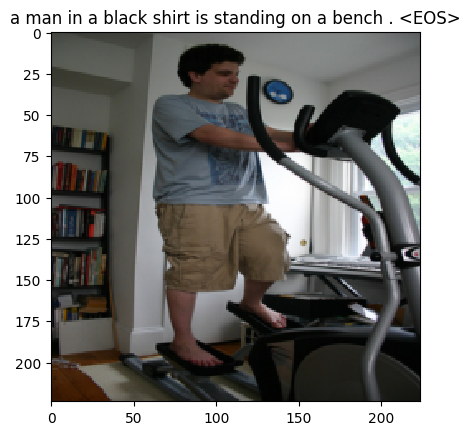

[Train] epoch: 2/3, step: 2650/3726, loss: 1.67979
[Train] epoch: 2/3, step: 2700/3726, loss: 1.41462


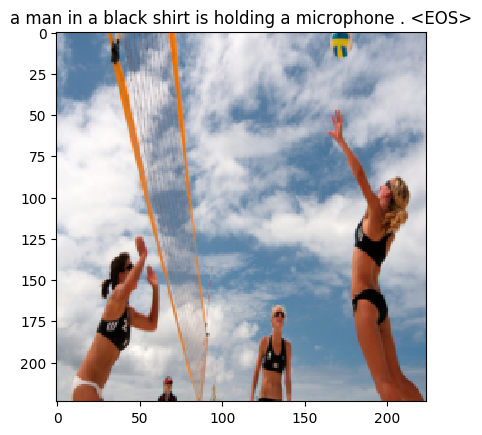

[Train] epoch: 2/3, step: 2750/3726, loss: 1.67502
[Train] epoch: 2/3, step: 2800/3726, loss: 1.54096


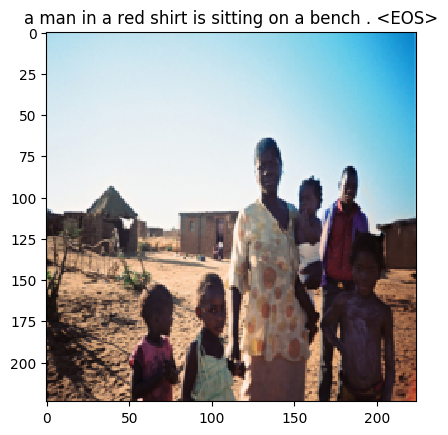

[Train] epoch: 2/3, step: 2850/3726, loss: 1.76077
[Train] epoch: 2/3, step: 2900/3726, loss: 1.60436


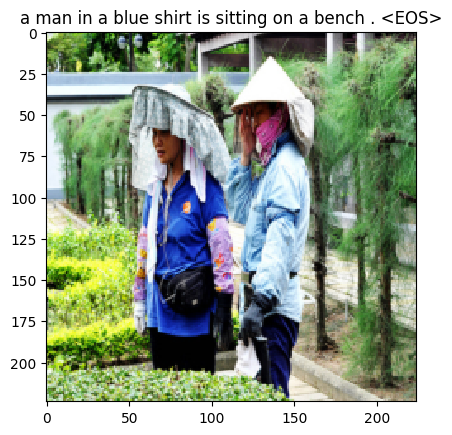

[Train] epoch: 2/3, step: 2950/3726, loss: 1.46906
[Train] epoch: 2/3, step: 3000/3726, loss: 1.50360


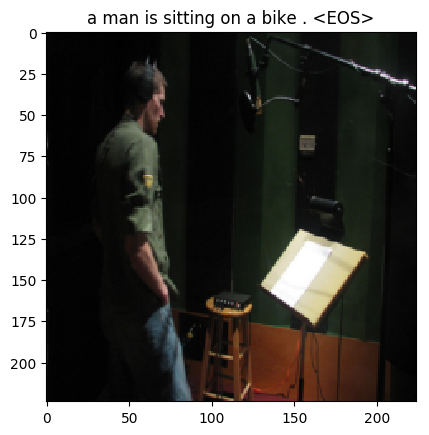

[Train] epoch: 2/3, step: 3050/3726, loss: 1.80430
[Train] epoch: 2/3, step: 3100/3726, loss: 1.71009


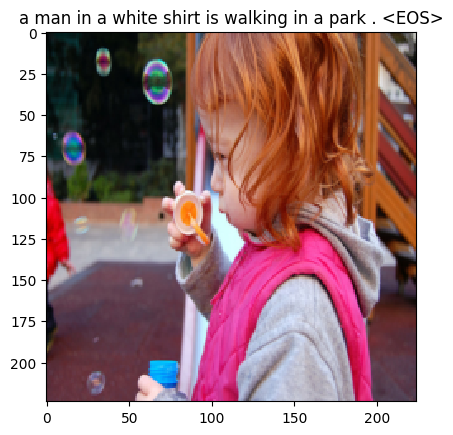

[Train] epoch: 2/3, step: 3150/3726, loss: 1.65770
[Train] epoch: 2/3, step: 3200/3726, loss: 1.36001


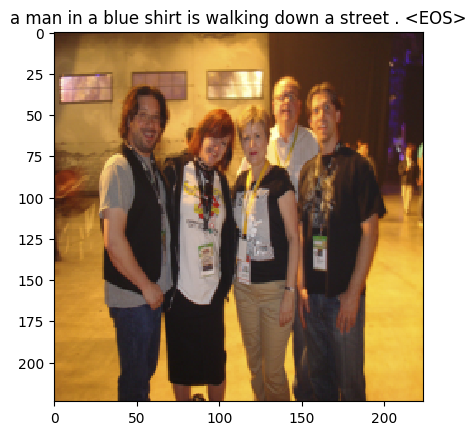

[Train] epoch: 2/3, step: 3250/3726, loss: 1.38603
[Train] epoch: 2/3, step: 3300/3726, loss: 1.54066


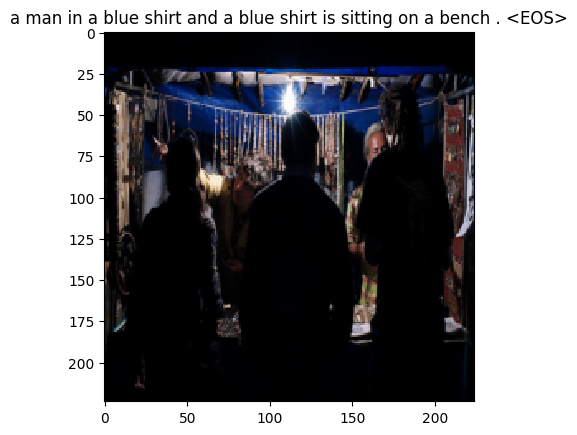

[Train] epoch: 2/3, step: 3350/3726, loss: 1.13242
[Train] epoch: 2/3, step: 3400/3726, loss: 1.03092


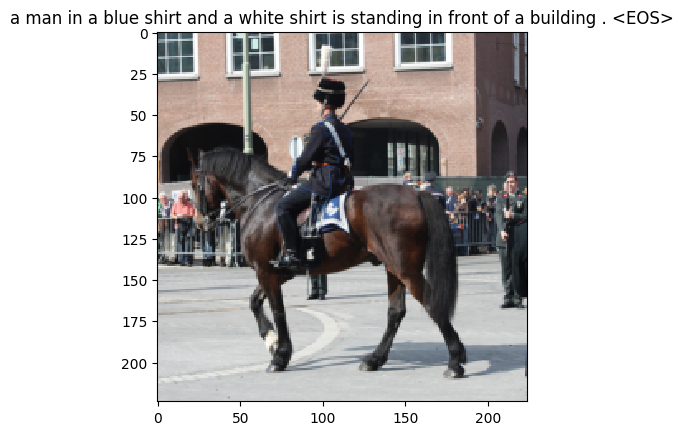

[Train] epoch: 2/3, step: 3450/3726, loss: 0.98098
[Train] epoch: 2/3, step: 3500/3726, loss: 1.53397


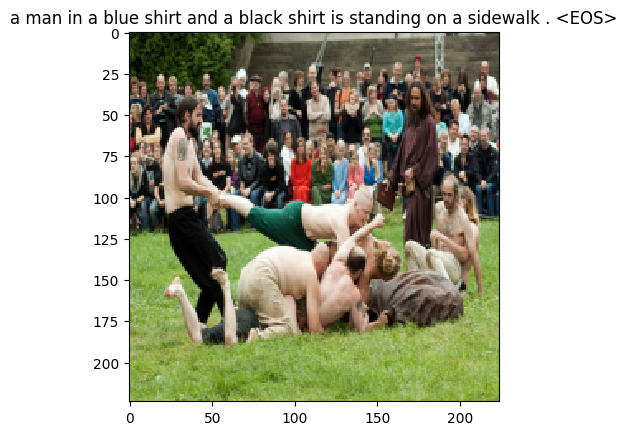

[Train] epoch: 2/3, step: 3550/3726, loss: 1.38342
[Train] epoch: 2/3, step: 3600/3726, loss: 1.37451


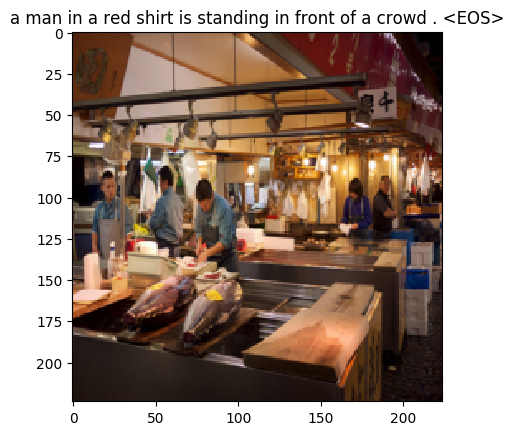

[Train] epoch: 2/3, step: 3650/3726, loss: 1.94377
[Train] epoch: 2/3, step: 3700/3726, loss: 1.62981


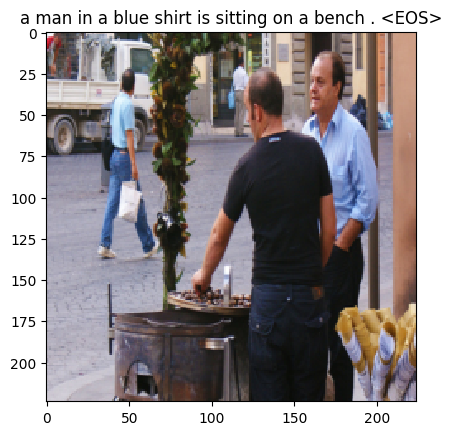

[Train] Training done!


In [ ]:
# 正则化
import random
import numpy as np
np.random.seed(102)
random.seed(102)
paddle.seed(102)

# 指定训练轮次
num_epochs = 10
#print('I am here')
embedding_size=64
vocab_size = len(dataset.vocabulary)
attention_dim=128
encoder_dim=2048
decoder_dim=256
learning_rate = 0.01

# 实例化模型
model_reg = model_image_caption(embedding_size,vocab_size,encoder_dim,attention_dim,decoder_dim,drop_prob=0.3)
#print('I am here')
# 指定优化器
optimizer_reg = paddle.optimizer.Adam(learning_rate=0.01, beta1=0.9, beta2=0.999, parameters= model_reg.parameters(),weight_decay=0.0001) 
# 指定损失函数
loss_fn_reg = paddle.nn.CrossEntropyLoss() 
# 指定评估指标
metric_reg = Accuracy()
# 实例化Runner
runner_reg = RunnerV3(model_reg, optimizer_reg, loss_fn_reg, metric_reg)
# 模型训练
runner_reg.train(dataloader,  num_epochs=3, draw_steps=100, log_steps=50, save_path="./checkpoints_reg/best.pdparams")

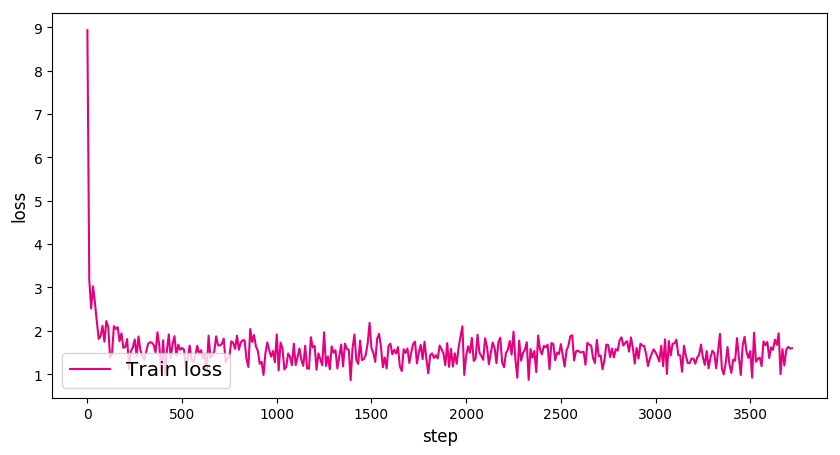

In [ ]:
fig_name = "./caption_regularization.pdf"
plot_training_loss_acc(runner_reg, fig_name, fig_size=(10,5), sample_step=10, loss_legend_loc="lower left")

效果依然不是很好，仍然不能分辨出男人、女人、动物、复杂的场景、人的个数，但是模型已经学会了更多的新单词，例如holding a drink等，已经比第一个模型略微高水平一些。下面进行数据增强，继续训练上面已经得到的第一个model。

In [19]:
# 图像增强
transform_en=T.Compose([T.Resize((224,224)),T.ColorJitter(0.3,0.3,0.3),T.ToTensor()])
dataset_enhance=MyDataset(root_dir='./flickr30k-images/',flickr_file='./flickr30k/results_20130124.token',transform=transform_en)

In [20]:
dataloader_enhance=DataLoader(dataset=dataset_enhance,batch_size=128,shuffle=True,collate_fn=CapCollate)

/opt/conda/envs/python35-paddle120-env/lib/python3.7/site-packages/paddle/fluid/dygraph/layers.py:1441: UserWarning: Skip loading for decoder.embedding.weight. decoder.embedding.weight receives a shape [7667, 64], but the expected shape is [7667, 128].
  warnings.warn(("Skip loading for {}. ".format(key) + str(err)))
/opt/conda/envs/python35-paddle120-env/lib/python3.7/site-packages/paddle/fluid/dygraph/layers.py:1441: UserWarning: Skip loading for decoder.lstm_cell.weight_ih. decoder.lstm_cell.weight_ih receives a shape [1024, 2112], but the expected shape is [1024, 2176].
  warnings.warn(("Skip loading for {}. ".format(key) + str(err)))
/opt/conda/envs/python35-paddle120-env/lib/python3.7/site-packages/paddle/tensor/creation.py:130: DeprecationWarning: `np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.o

[Train] epoch: 0/3, step: 0/3726, loss: 8.82521


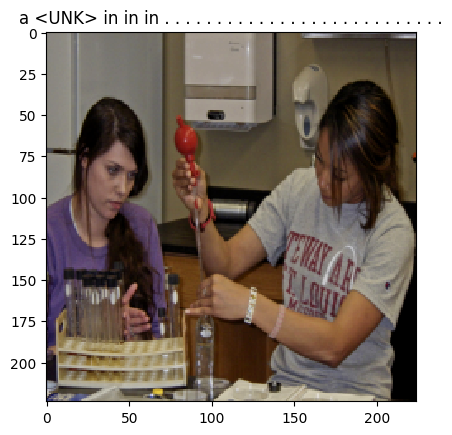

[Train] epoch: 0/3, step: 50/3726, loss: 1.79318
[Train] epoch: 0/3, step: 100/3726, loss: 1.85121


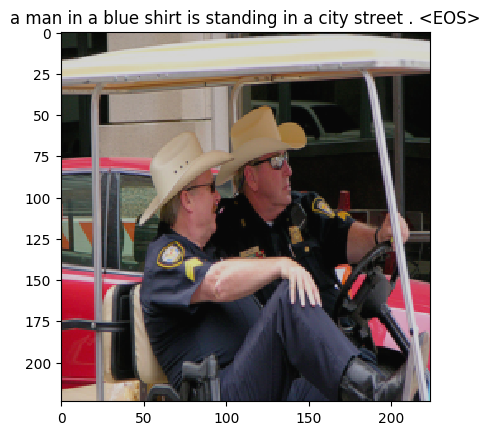

[Train] epoch: 0/3, step: 150/3726, loss: 1.72486
[Train] epoch: 0/3, step: 200/3726, loss: 1.37943


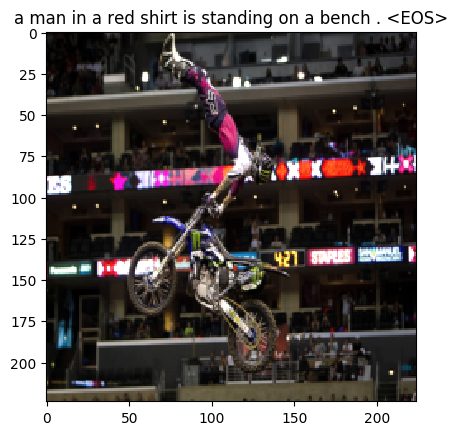

[Train] epoch: 0/3, step: 250/3726, loss: 1.49417
[Train] epoch: 0/3, step: 300/3726, loss: 1.12761


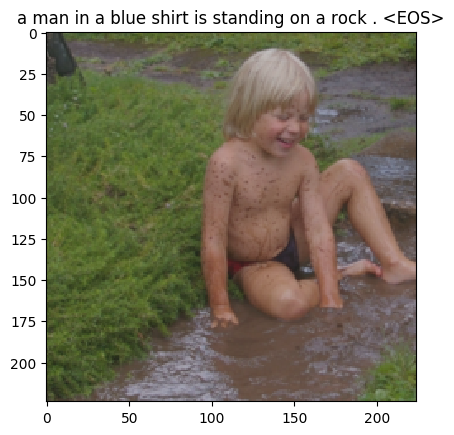

[Train] epoch: 0/3, step: 350/3726, loss: 1.39414
[Train] epoch: 0/3, step: 400/3726, loss: 1.51143


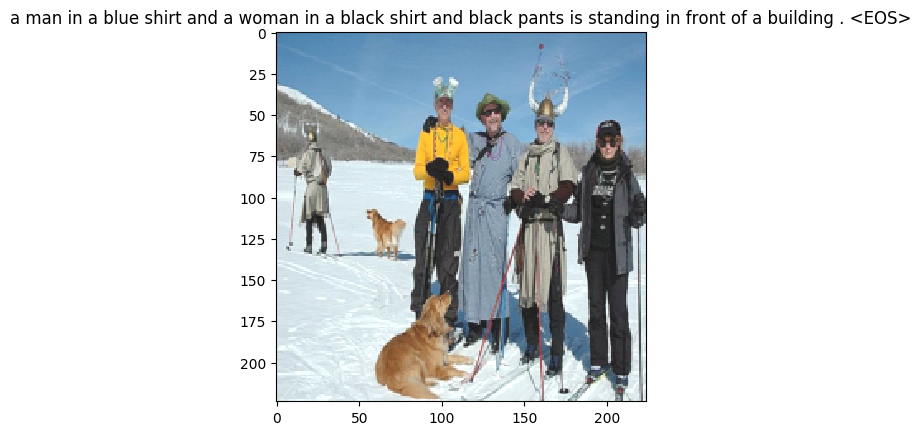

[Train] epoch: 0/3, step: 450/3726, loss: 1.41903
[Train] epoch: 0/3, step: 500/3726, loss: 1.33232


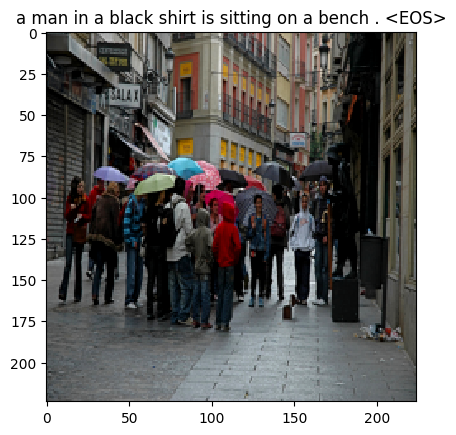

[Train] epoch: 0/3, step: 550/3726, loss: 1.12055
[Train] epoch: 0/3, step: 600/3726, loss: 1.28183


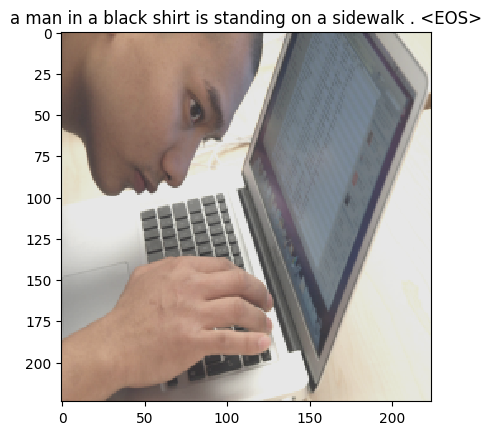

[Train] epoch: 0/3, step: 650/3726, loss: 1.15843
[Train] epoch: 0/3, step: 700/3726, loss: 1.38663


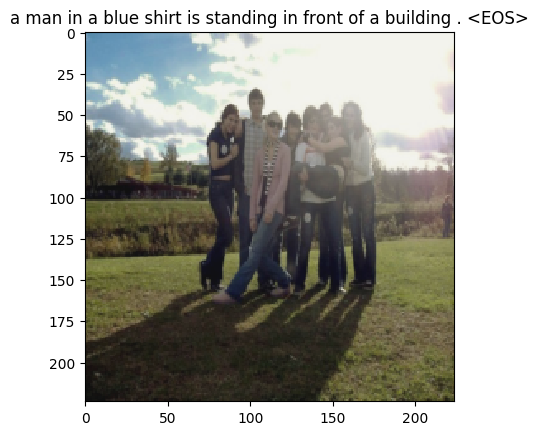

[Train] epoch: 0/3, step: 750/3726, loss: 1.16410
[Train] epoch: 0/3, step: 800/3726, loss: 1.30871


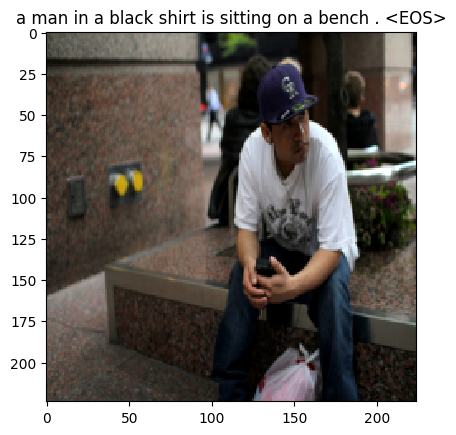

[Train] epoch: 0/3, step: 850/3726, loss: 0.96992
[Train] epoch: 0/3, step: 900/3726, loss: 1.28250


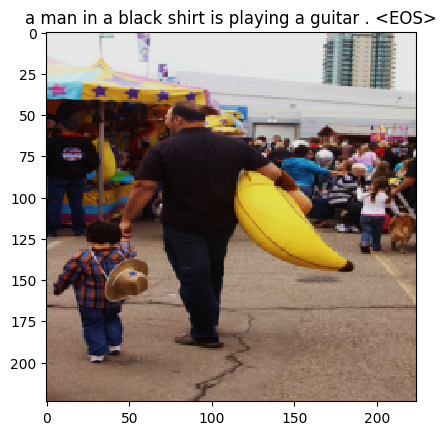

[Train] epoch: 0/3, step: 950/3726, loss: 1.45140
[Train] epoch: 0/3, step: 1000/3726, loss: 1.58084


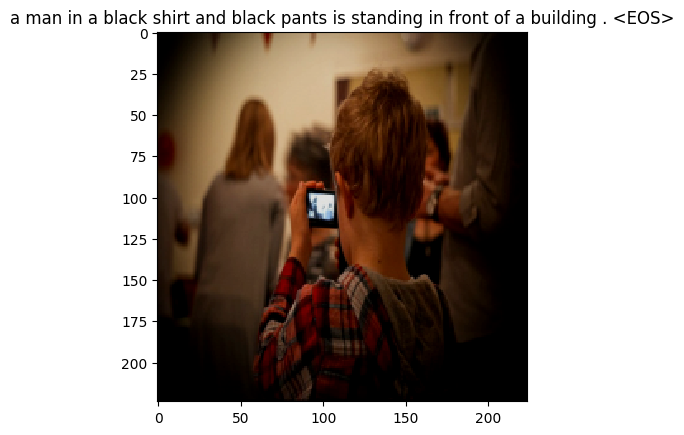

[Train] epoch: 0/3, step: 1050/3726, loss: 0.98751
[Train] epoch: 0/3, step: 1100/3726, loss: 0.99693


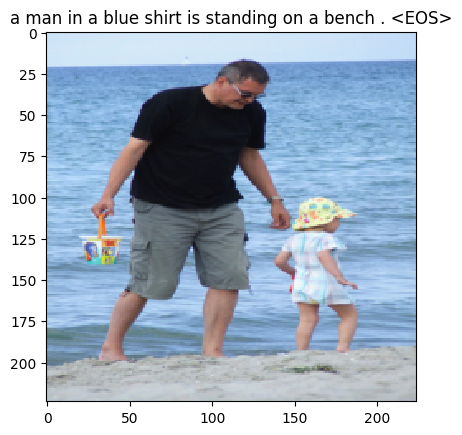

[Train] epoch: 0/3, step: 1150/3726, loss: 1.35975
[Train] epoch: 0/3, step: 1200/3726, loss: 1.36703


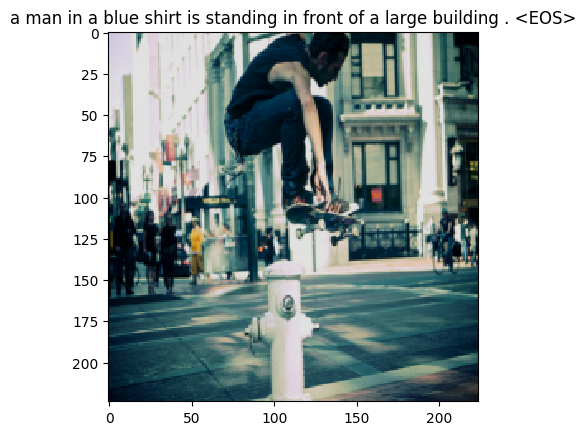

[Train] epoch: 1/3, step: 1250/3726, loss: 1.60008
[Train] epoch: 1/3, step: 1300/3726, loss: 1.19708


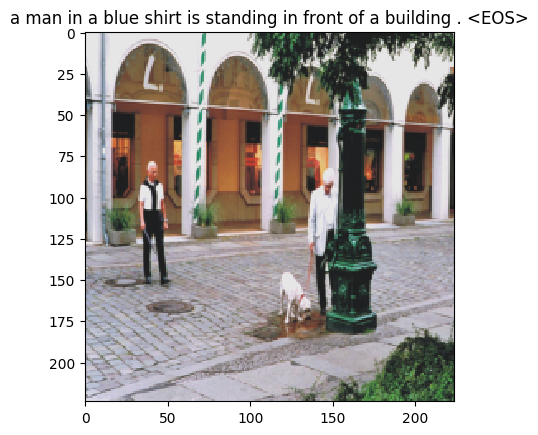

[Train] epoch: 1/3, step: 1350/3726, loss: 0.95050
[Train] epoch: 1/3, step: 1400/3726, loss: 1.27992


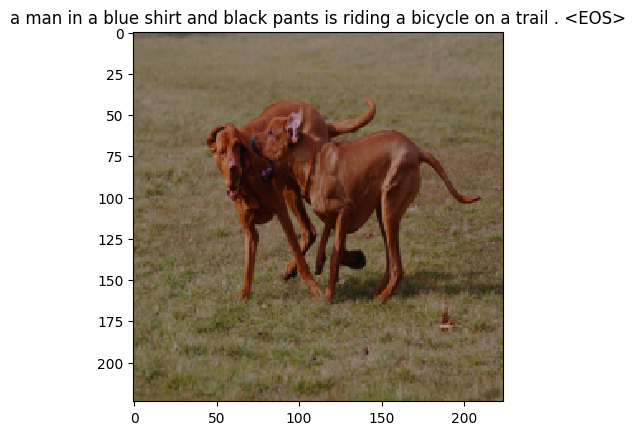

[Train] epoch: 1/3, step: 1450/3726, loss: 1.08157
[Train] epoch: 1/3, step: 1500/3726, loss: 1.29522


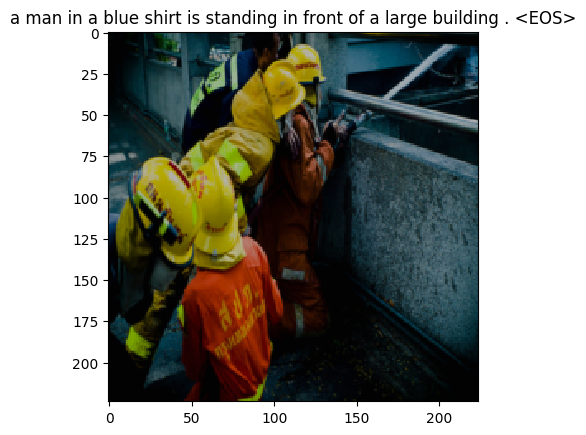

[Train] epoch: 1/3, step: 1550/3726, loss: 1.34492
[Train] epoch: 1/3, step: 1600/3726, loss: 1.37126


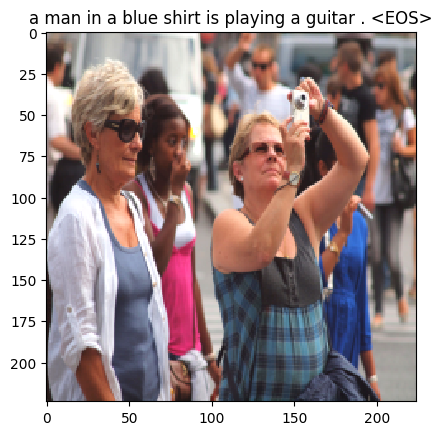

[Train] epoch: 1/3, step: 1650/3726, loss: 0.94591
[Train] epoch: 1/3, step: 1700/3726, loss: 1.02618


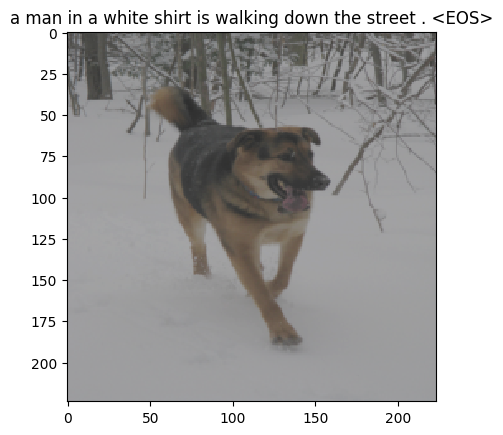

[Train] epoch: 1/3, step: 1750/3726, loss: 1.24737
[Train] epoch: 1/3, step: 1800/3726, loss: 0.82876


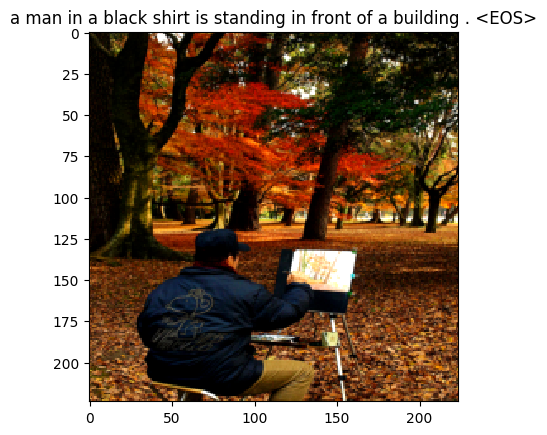

[Train] epoch: 1/3, step: 1850/3726, loss: 1.10455
[Train] epoch: 1/3, step: 1900/3726, loss: 1.42037


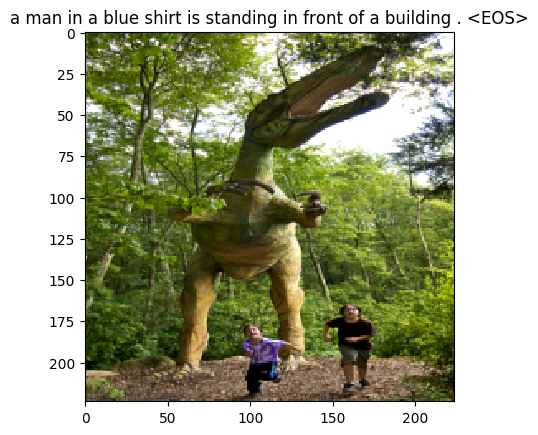

[Train] epoch: 1/3, step: 1950/3726, loss: 1.00564
[Train] epoch: 1/3, step: 2000/3726, loss: 1.15656


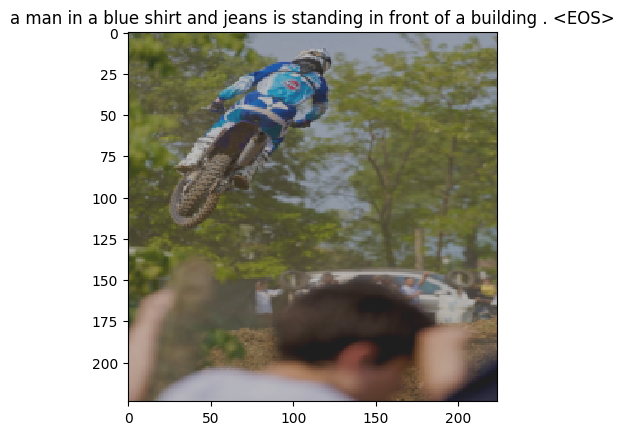

[Train] epoch: 1/3, step: 2050/3726, loss: 1.11635
[Train] epoch: 1/3, step: 2100/3726, loss: 1.47700


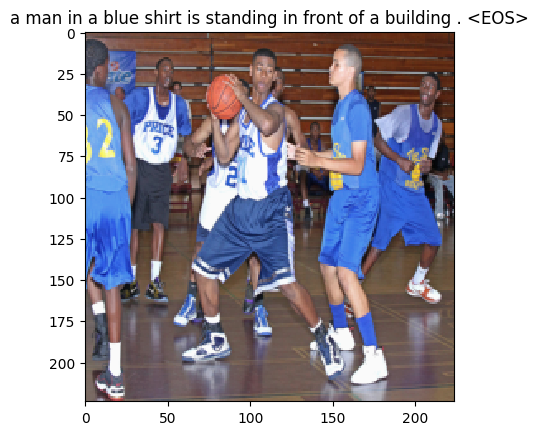

[Train] epoch: 1/3, step: 2150/3726, loss: 1.30788
[Train] epoch: 1/3, step: 2200/3726, loss: 0.95015


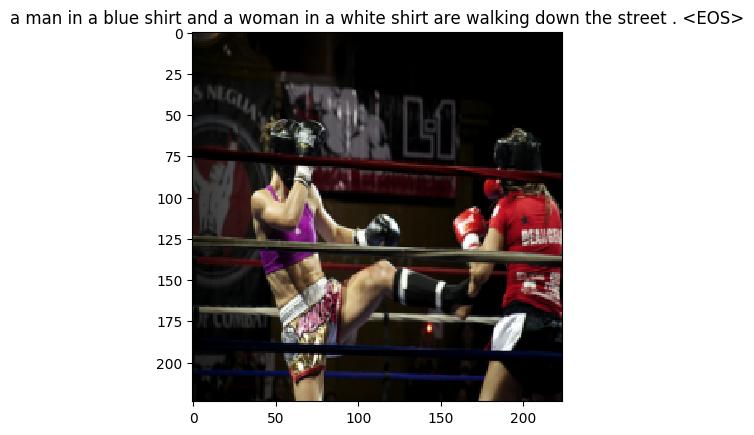

[Train] epoch: 1/3, step: 2250/3726, loss: 1.61410
[Train] epoch: 1/3, step: 2300/3726, loss: 1.19178


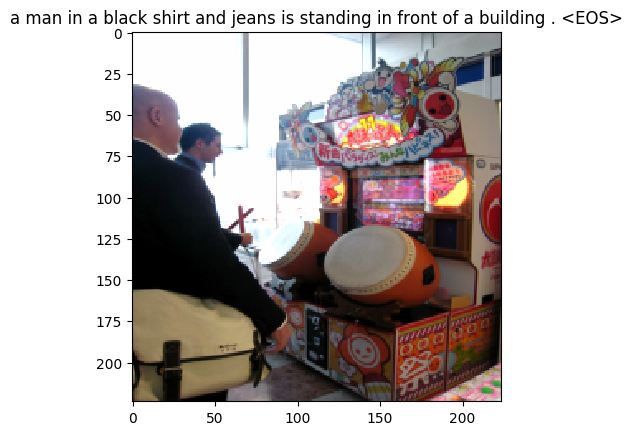

[Train] epoch: 1/3, step: 2350/3726, loss: 1.10929
[Train] epoch: 1/3, step: 2400/3726, loss: 1.17737


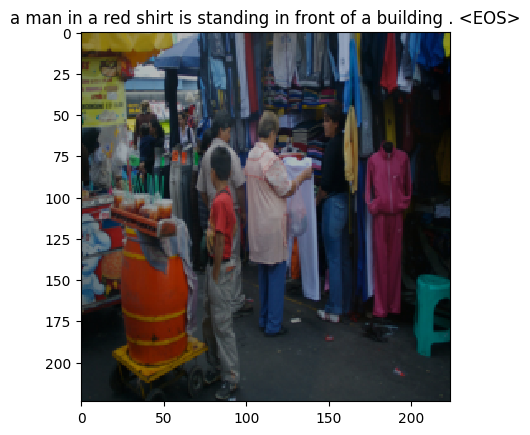

[Train] epoch: 1/3, step: 2450/3726, loss: 1.39833
[Train] epoch: 2/3, step: 2500/3726, loss: 1.32620


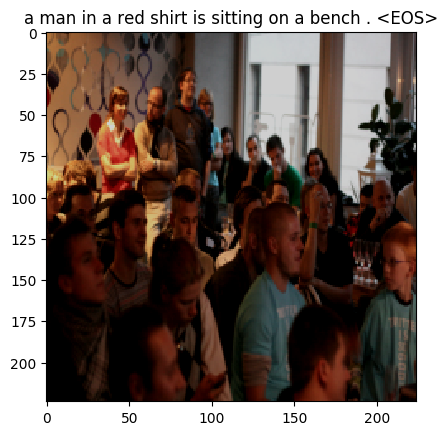

[Train] epoch: 2/3, step: 2550/3726, loss: 1.46288
[Train] epoch: 2/3, step: 2600/3726, loss: 1.17862


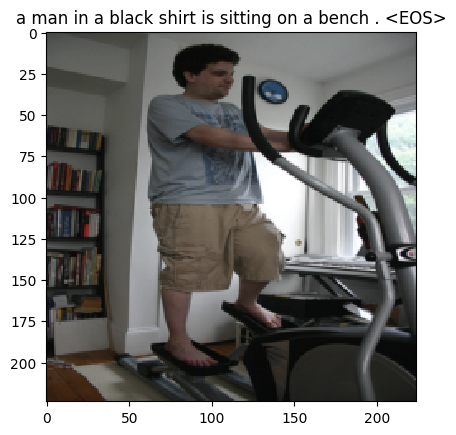

[Train] epoch: 2/3, step: 2650/3726, loss: 1.33107
[Train] epoch: 2/3, step: 2700/3726, loss: 1.11364


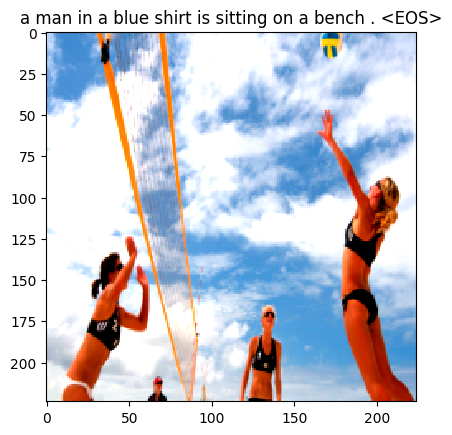

[Train] epoch: 2/3, step: 2750/3726, loss: 1.31185
[Train] epoch: 2/3, step: 2800/3726, loss: 1.22930


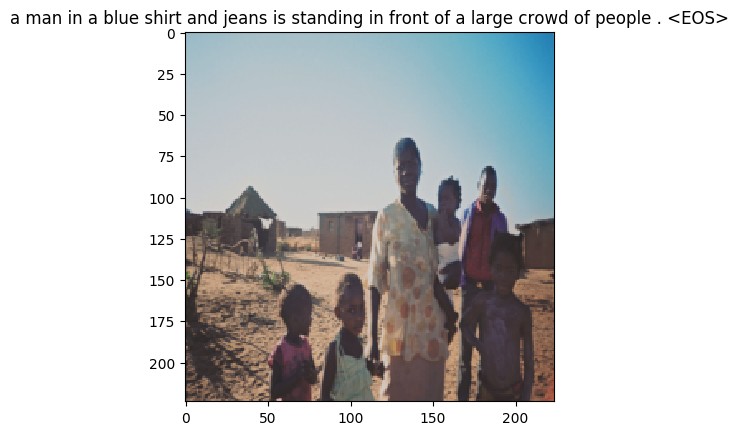

[Train] epoch: 2/3, step: 2850/3726, loss: 1.37148
[Train] epoch: 2/3, step: 2900/3726, loss: 1.26641


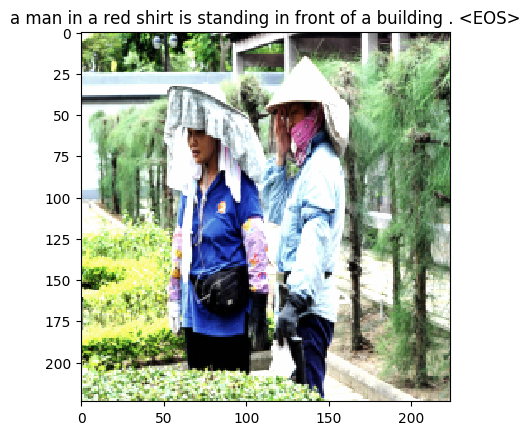

[Train] epoch: 2/3, step: 2950/3726, loss: 1.16891
[Train] epoch: 2/3, step: 3000/3726, loss: 1.19411


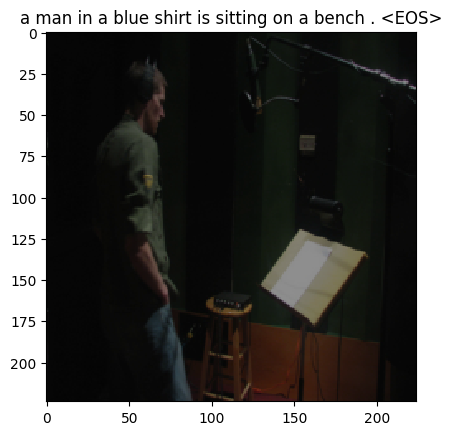

[Train] epoch: 2/3, step: 3050/3726, loss: 1.40992
[Train] epoch: 2/3, step: 3100/3726, loss: 1.36838


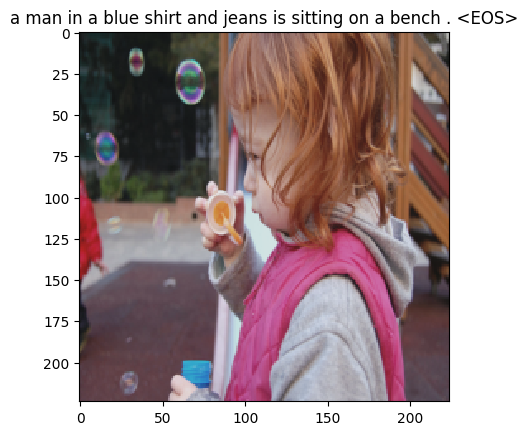

[Train] epoch: 2/3, step: 3150/3726, loss: 1.32642
[Train] epoch: 2/3, step: 3200/3726, loss: 1.07773


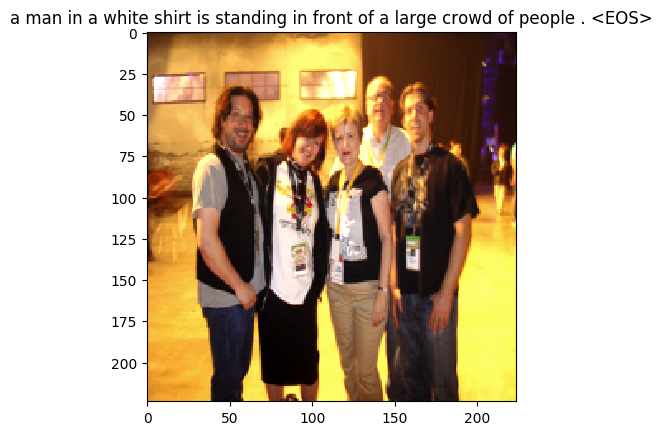

[Train] epoch: 2/3, step: 3250/3726, loss: 1.11196
[Train] epoch: 2/3, step: 3300/3726, loss: 1.22849


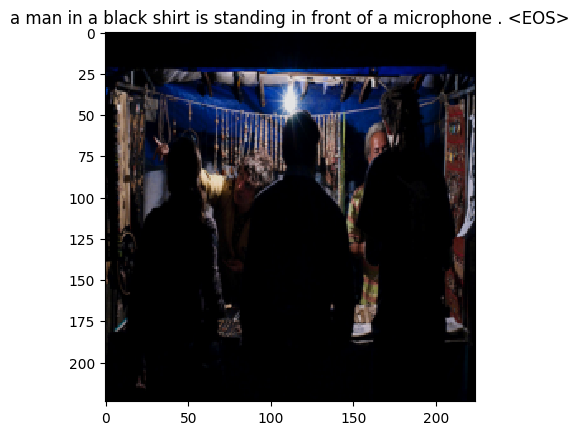

[Train] epoch: 2/3, step: 3350/3726, loss: 0.90132
[Train] epoch: 2/3, step: 3400/3726, loss: 0.82391


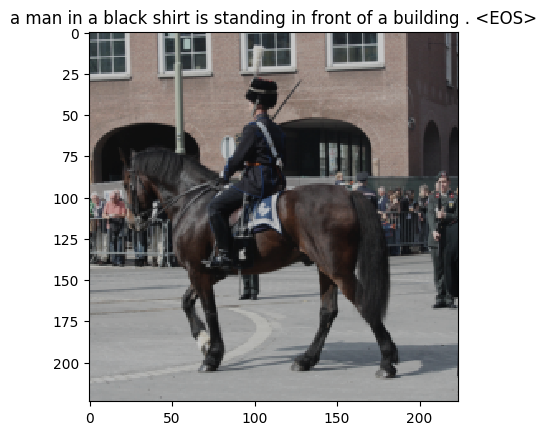

[Train] epoch: 2/3, step: 3450/3726, loss: 0.78935
[Train] epoch: 2/3, step: 3500/3726, loss: 1.23712


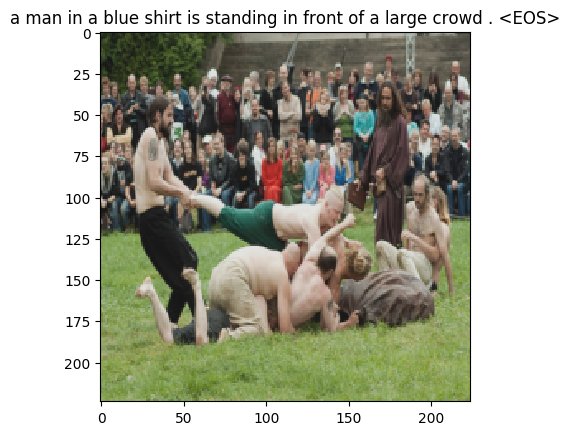

[Train] epoch: 2/3, step: 3550/3726, loss: 1.10098
[Train] epoch: 2/3, step: 3600/3726, loss: 1.08496


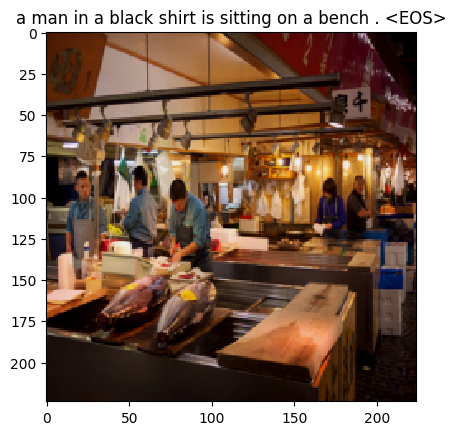

[Train] epoch: 2/3, step: 3650/3726, loss: 1.56523
[Train] epoch: 2/3, step: 3700/3726, loss: 1.31939


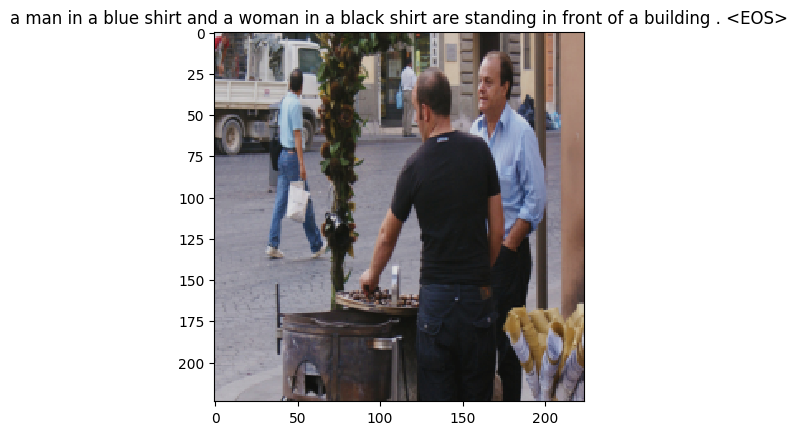

[Train] Training done!


In [21]:
model_path = "./checkpoints_ori/best.pdparams"
import numpy as np
import random
np.random.seed(102)
random.seed(102)
paddle.seed(102)

# 指定训练轮次
num_epochs = 3
#print('I am here')
embedding_size=128
vocab_size = len(dataset.vocabulary)
attention_dim=128
encoder_dim=2048
decoder_dim=256
learning_rate = 0.01

# 实例化模型
model_enhance = model_image_caption(embedding_size,vocab_size,encoder_dim,attention_dim,decoder_dim,drop_prob=0.25)
#print('I am here')
# 指定优化器
optimizer_enhance = paddle.optimizer.Adam(learning_rate=learning_rate, beta1=0.9, beta2=0.999, parameters= model_enhance.parameters()) 
# 指定损失函数
loss_fn_enhance = paddle.nn.CrossEntropyLoss() 
# 指定评估指标
metric_enhance = Accuracy()
# 实例化Runner
runner_enhance = RunnerV3(model_enhance, optimizer_enhance, loss_fn_enhance, metric_enhance)
# 模型训练

# 先导入训练好的参数
runner_enhance.load_model(model_path)
runner_enhance.train(dataloader_enhance,  num_epochs=num_epochs, draw_steps=100, log_steps=50, save_path="./checkpoints_enhance/best.pdparams")

可以看到，模型这次学会了更多的新单词，但还是无法准确辨别图片场景。

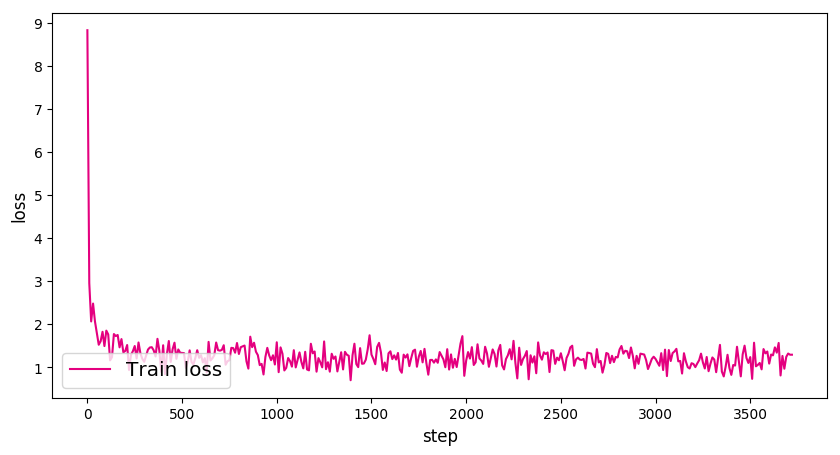

In [22]:
fig_name = "./caption_enhancement.pdf"
plot_training_loss_acc(runner_enhance, fig_name, fig_size=(10,5), sample_step=10, loss_legend_loc="lower left")

下面尝试了beam search但未能成行。

In [ ]:
# beam search
import math
def caption_image_beam_search(encoder, decoder, idx, word_map, beam_size=3):

    k = beam_size
    vocab_size = len(word_map)

    # Read image and process
    img,_ = dataset[idx]
    # if len(img.shape) == 2:
    #     img = img[:, :, np.newaxis]
    #     img = paddle.concat([img, img, img], axis=2)
    transform_2 = T.Resize(size=224)
    img = transform_2(img)
    # print(img.shape)
    # img = img.transpose([2, 0, 1])
    # img = img / 255.
    # img = paddle.to_tensor(img)
    # normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
    #                                  std=[0.229, 0.224, 0.225])
    # transform = transforms.Compose([normalize])
    # image = transform(img)  # (3, 256, 256)

    # Encode
    image = img.unsqueeze(0)  # (1, 3, 224, 224)
    encoder_out = encoder(image)  # (1, enc_image_size* enc_image_size, encoder_dim)
    # print(encoder_out.shape)
    enc_image_size = int(math.sqrt(encoder_out.shape[1]))
    encoder_dim = encoder_out.shape[2]

    # Flatten encoding
    encoder_out = encoder_out.reshape([1, -1, encoder_dim])  # (1, num_pixels, encoder_dim)
    num_pixels = encoder_out.shape[1]

    # We'll treat the problem as having a batch size of k
    encoder_out = encoder_out.expand([k, num_pixels, encoder_dim])  # (k, num_pixels, encoder_dim)

    # Tensor to store top k previous words at each step; now they're just <start>
    k_prev_words = paddle.to_tensor([[word_map.stoi['<SOS>']]] * k)  # (k, 1)

    # Tensor to store top k sequences; now they're just <start>
    seqs = k_prev_words  # (k, 1)

    # Tensor to store top k sequences' scores; now they're just 0
    top_k_scores = paddle.zeros([k, 1])  # (k, 1)

    # Tensor to store top k sequences' alphas; now they're just 1s
    # seqs_alpha = paddle.ones([k, 1, enc_image_size, enc_image_size])  # (k, 1, enc_image_size, enc_image_size)

    # Lists to store completed sequences, their alphas and scores
    complete_seqs = list()
    # complete_seqs_alpha = list()
    complete_seqs_scores = list()

    # Start decoding
    step = 1
    h, c = decoder.init_hidden_state(encoder_out)

    # s is a number less than or equal to k, because sequences are removed from this process once they hit <end>
    while True:

        embeddings = decoder.embedding(k_prev_words).squeeze(1)  # (s, embed_dim)

        awe, _ = decoder.attention(encoder_out, h)  # (s, encoder_dim), (s, num_pixels)

        #alpha = alpha.reshape([-1, enc_image_size, enc_image_size])  # (s, enc_image_size, enc_image_size)

        gate = F.sigmoid(decoder.f_beta(h))  # gating scalar, (s, encoder_dim)
        awe = gate * awe

        h, c = decoder.decode_step(paddle.concat([embeddings, awe], axis=1), (h, c))  # (s, decoder_dim)

        scores = decoder.fcn(h)  # (s, vocab_size)
        scores = F.log_softmax(scores, axis=1)

        # Add
        scores = top_k_scores.expand_as(scores) + scores  # (s, vocab_size)

        # For the first step, all k points will have the same scores (since same k previous words, h, c)
        if step == 1:
            top_k_scores, top_k_words = scores[0].topk(k, 0, True, True)  # (s)
        else:
            # Unroll and find top scores, and their unrolled indices
            top_k_scores, top_k_words = scores.reshape([-1]).topk(k, 0, True, True)  # (s)

        # Convert unrolled indices to actual indices of scores
        prev_word_inds = top_k_words / vocab_size  # (s)
        next_word_inds = top_k_words % vocab_size  # (s)

        # Add new words to sequences, alphas
        seqs = paddle.concat([seqs[prev_word_inds], next_word_inds.unsqueeze(1)], dim=1)  # (s, step+1)
        #seqs_alpha = paddle.concat([seqs_alpha[prev_word_inds], alpha[prev_word_inds].unsqueeze(1)],
        #                      dim=1)  # (s, step+1, enc_image_size, enc_image_size)

        # Which sequences are incomplete (didn't reach <end>)?
        incomplete_inds = [ind for ind, next_word in enumerate(next_word_inds) if next_word != word_map.stoi['<EOS>']]
        complete_inds = list(set(range(len(next_word_inds))) - set(incomplete_inds))

        # Set aside complete sequences
        if len(complete_inds) > 0:
            complete_seqs.extend(seqs[complete_inds].tolist())
            #complete_seqs_alpha.extend(seqs_alpha[complete_inds].tolist())
            complete_seqs_scores.extend(top_k_scores[complete_inds])
        k -= len(complete_inds)  # reduce beam length accordingly

        # Proceed with incomplete sequences
        if k == 0:
            break
        seqs = seqs[incomplete_inds]
        #seqs_alpha = seqs_alpha[incomplete_inds]
        h = h[prev_word_inds[incomplete_inds]]
        c = c[prev_word_inds[incomplete_inds]]
        encoder_out = encoder_out[prev_word_inds[incomplete_inds]]
        top_k_scores = top_k_scores[incomplete_inds].unsqueeze(1)
        k_prev_words = next_word_inds[incomplete_inds].unsqueeze(1)

        # Break if things have been going on too long
        if step > 32:
            break
        step += 1

    i = complete_seqs_scores.index(max(complete_seqs_scores))
    seq = complete_seqs[i]
    #alphas = complete_seqs_alpha[i]

    return seq

In [ ]:
model_path = "./checkpoints/best.pdparams"
runner.load_model(model_path)
caption_image_beam_search(runner.model.encoder, runner.model.decoder, idx=1000, word_map=dataset.vocabulary, beam_size=3)